<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_DuplicateIMG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
temp_array  = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        
        #if img.shape[0] != img.shape[1]:
        #    img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))

        X_train.append(image)
image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                  temp_array.append(k)
                temp_array.pop(0)

                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size

                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)

                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size 

                lbls_array.append(temp_array)                
            
                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
    rescale = 1./255,
    rotation_range=10,
    width_shift_range=0.05,
    height_shift_range=0.05,
    zoom_range=0.1,
    #horizontal_flip=True
    )
val_data_gen = ImageDataGenerator(rescale = 1./255
)
test_data_gen = ImageDataGenerator(rescale = 1./255
)


In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[180,180, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 180, 180, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 8)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 16)        1168      
                                                                 
 batch_normalization_1 (Batc  (None, 90, 90, 16)       64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
callbacks_list = [
    ShowTestImages()
]

In [21]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [22]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/100
8/8 [==============================] - 1s 89ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 44ms/step
4


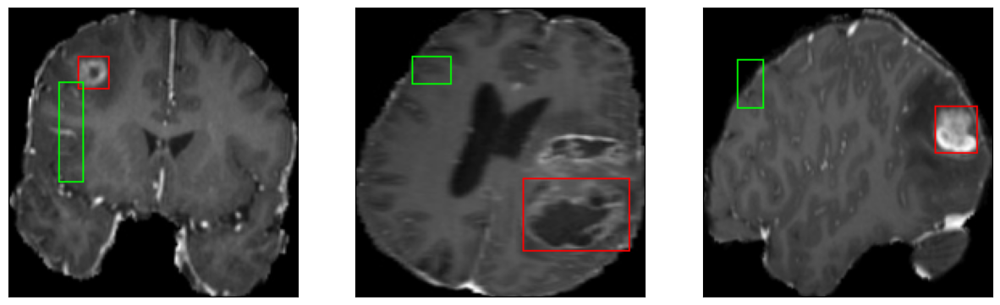

52/52 [==============================] - 35s 275ms/step - loss: 27.5442 - IoU: 0.0586 - val_loss: 36.2069 - val_IoU: 0.0154
Epoch 2/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


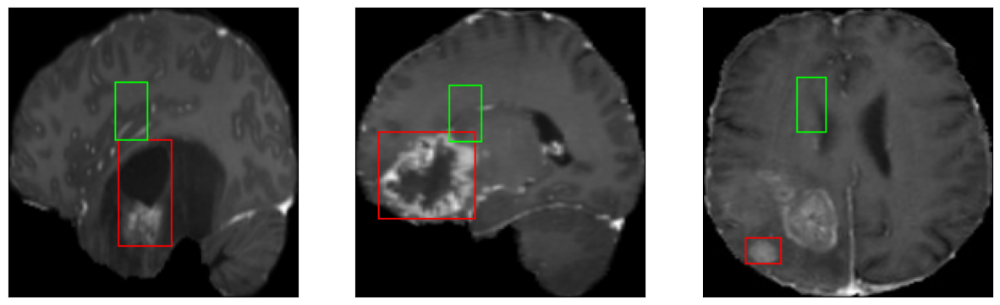

52/52 [==============================] - 10s 186ms/step - loss: 23.7711 - IoU: 0.0634 - val_loss: 24.9881 - val_IoU: 0.0512
Epoch 3/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4


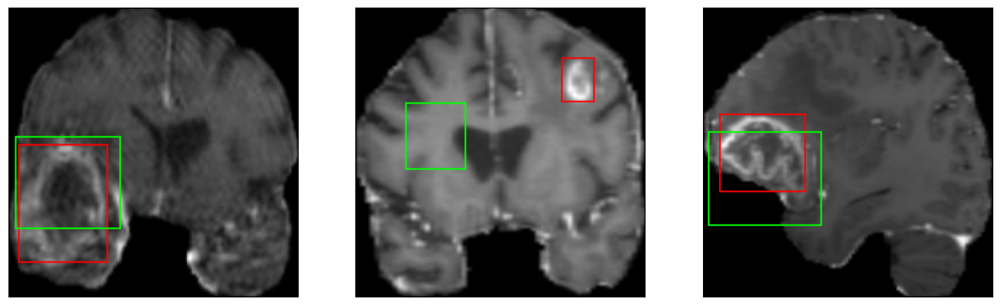

52/52 [==============================] - 10s 193ms/step - loss: 20.4952 - IoU: 0.1044 - val_loss: 23.9001 - val_IoU: 0.1037
Epoch 4/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


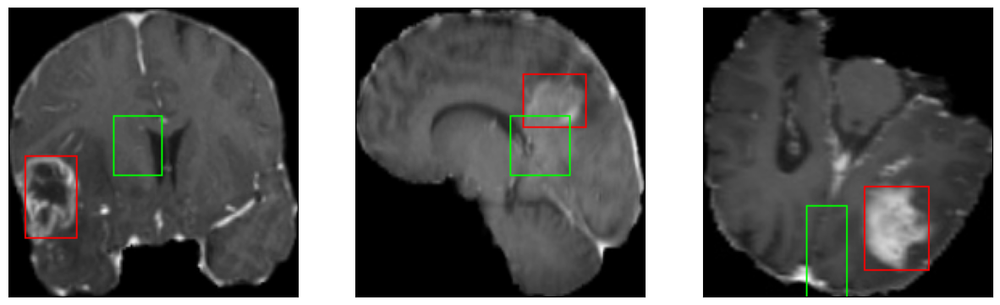

52/52 [==============================] - 10s 196ms/step - loss: 18.6063 - IoU: 0.1441 - val_loss: 22.7201 - val_IoU: 0.1107
Epoch 5/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4


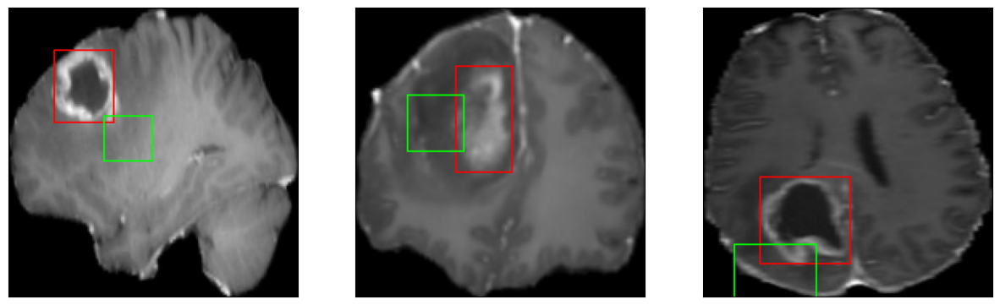

52/52 [==============================] - 10s 185ms/step - loss: 17.3052 - IoU: 0.1644 - val_loss: 16.4745 - val_IoU: 0.1946
Epoch 6/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 37ms/step
4


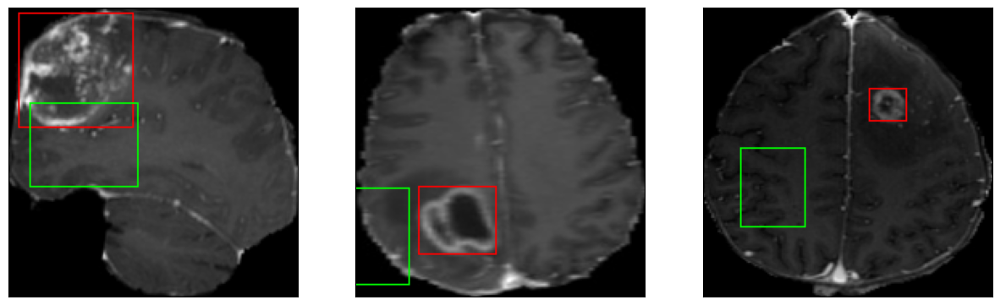

52/52 [==============================] - 10s 188ms/step - loss: 15.8948 - IoU: 0.2005 - val_loss: 21.2717 - val_IoU: 0.1347
Epoch 7/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


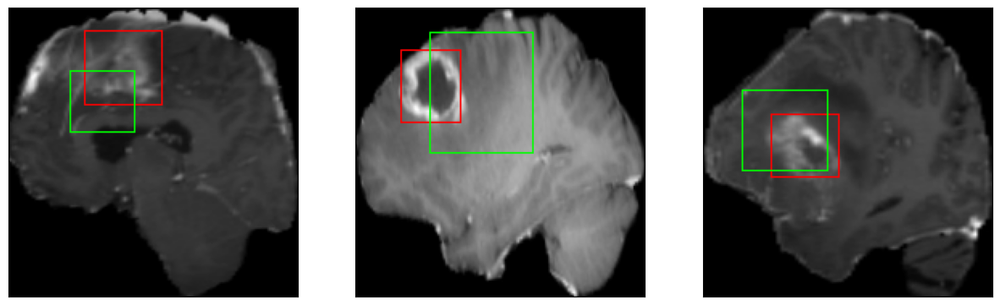

52/52 [==============================] - 10s 195ms/step - loss: 15.2298 - IoU: 0.2196 - val_loss: 17.0435 - val_IoU: 0.2299
Epoch 8/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


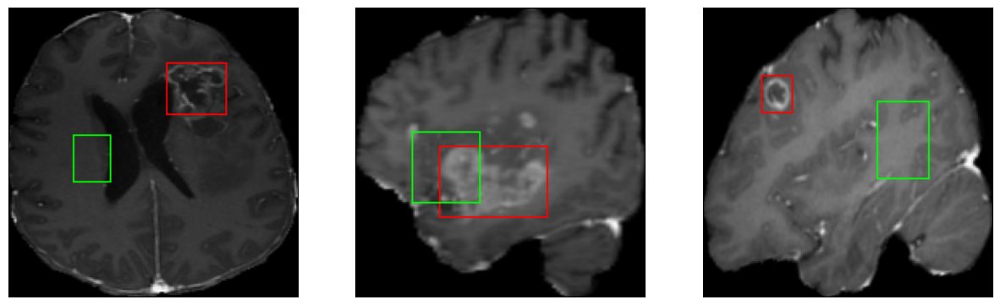

52/52 [==============================] - 10s 191ms/step - loss: 14.0663 - IoU: 0.2383 - val_loss: 17.5643 - val_IoU: 0.2606
Epoch 9/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


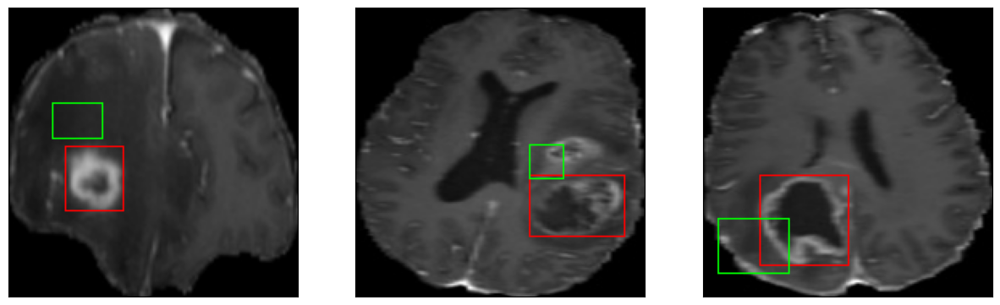

52/52 [==============================] - 10s 187ms/step - loss: 13.3688 - IoU: 0.2608 - val_loss: 15.5966 - val_IoU: 0.2166
Epoch 10/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


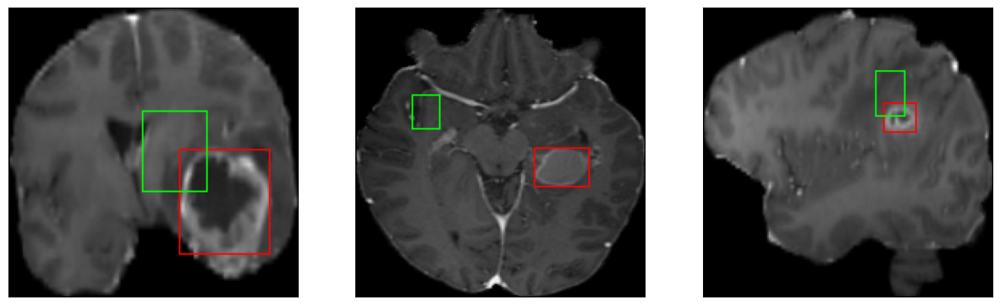

52/52 [==============================] - 10s 201ms/step - loss: 13.2326 - IoU: 0.2649 - val_loss: 15.7840 - val_IoU: 0.2315
Epoch 11/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


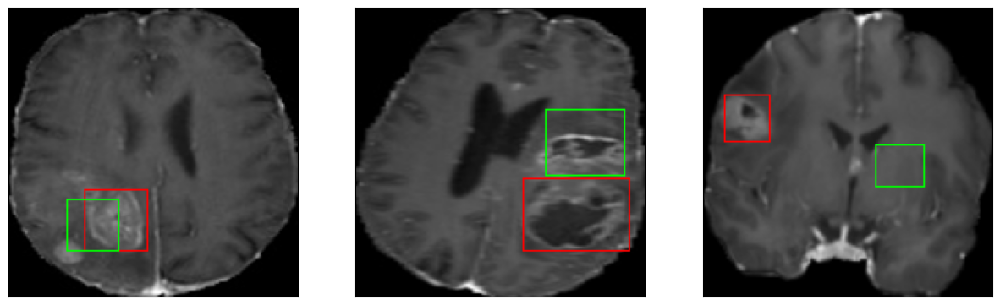

52/52 [==============================] - 11s 209ms/step - loss: 13.2680 - IoU: 0.2593 - val_loss: 13.5679 - val_IoU: 0.2632
Epoch 12/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


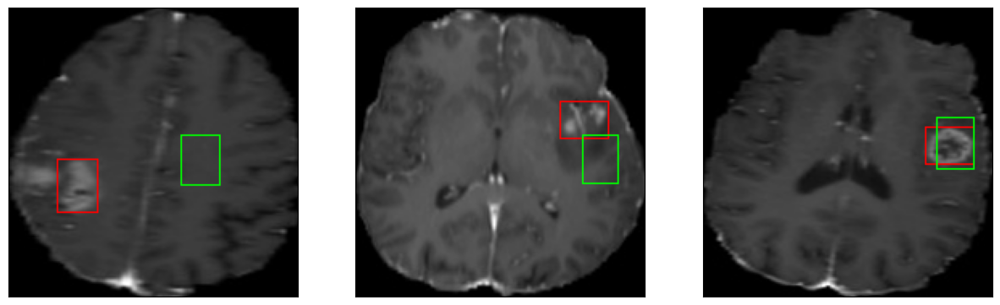

52/52 [==============================] - 10s 199ms/step - loss: 11.5582 - IoU: 0.3139 - val_loss: 12.2787 - val_IoU: 0.2991
Epoch 13/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


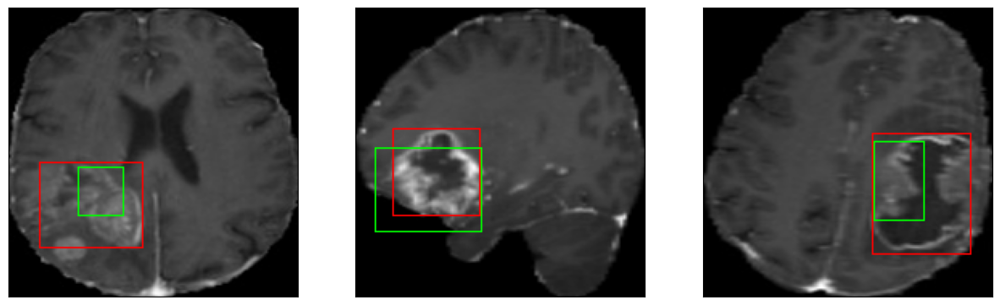

52/52 [==============================] - 10s 200ms/step - loss: 10.8075 - IoU: 0.3376 - val_loss: 12.2022 - val_IoU: 0.3260
Epoch 14/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


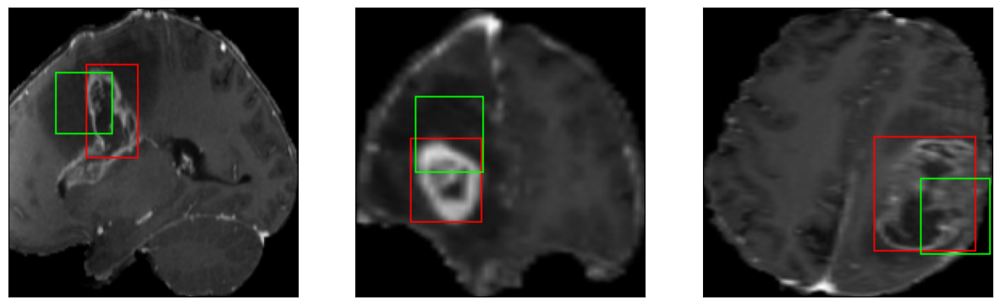

52/52 [==============================] - 11s 204ms/step - loss: 10.5323 - IoU: 0.3476 - val_loss: 12.0988 - val_IoU: 0.2999
Epoch 15/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


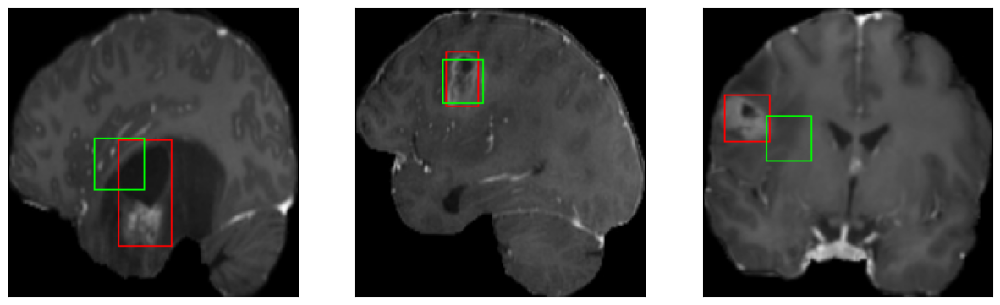

52/52 [==============================] - 10s 193ms/step - loss: 11.1126 - IoU: 0.3302 - val_loss: 12.0785 - val_IoU: 0.3472
Epoch 16/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4


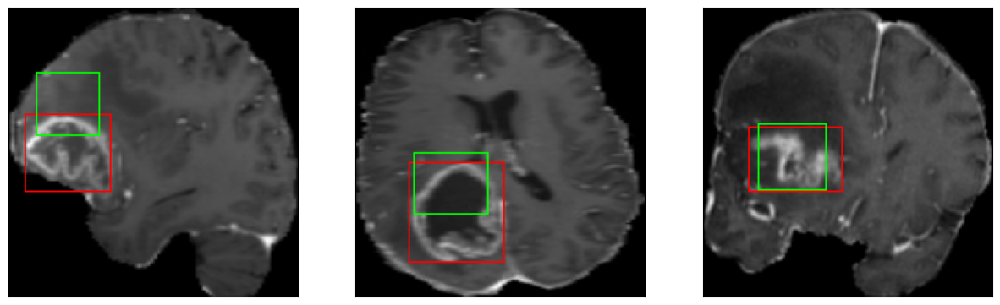

52/52 [==============================] - 11s 203ms/step - loss: 10.5693 - IoU: 0.3328 - val_loss: 11.0591 - val_IoU: 0.3239
Epoch 17/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


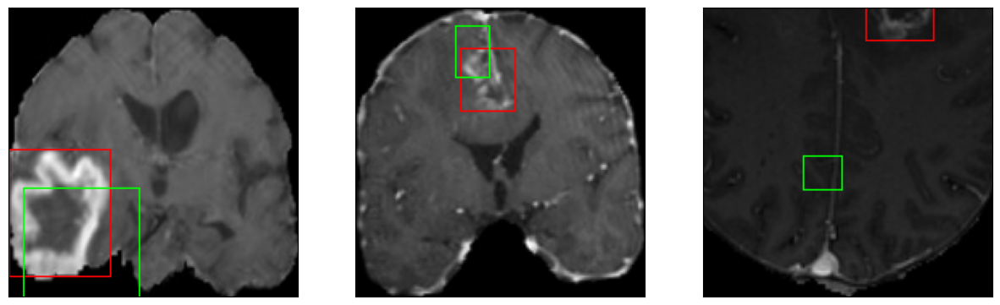

52/52 [==============================] - 11s 209ms/step - loss: 9.9712 - IoU: 0.3571 - val_loss: 9.7743 - val_IoU: 0.3982
Epoch 18/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4


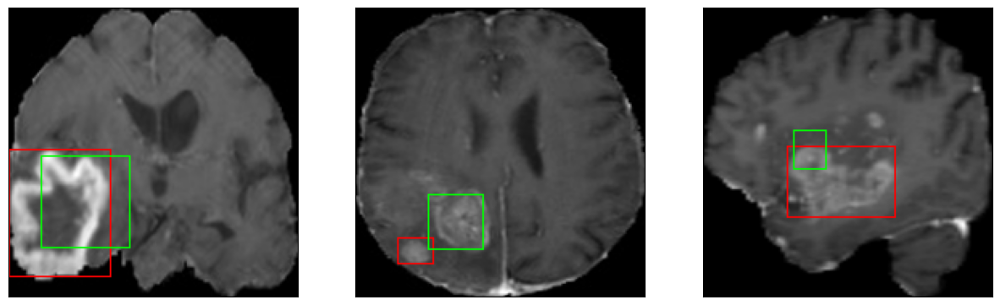

52/52 [==============================] - 11s 212ms/step - loss: 9.8224 - IoU: 0.3562 - val_loss: 12.1061 - val_IoU: 0.3246
Epoch 19/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


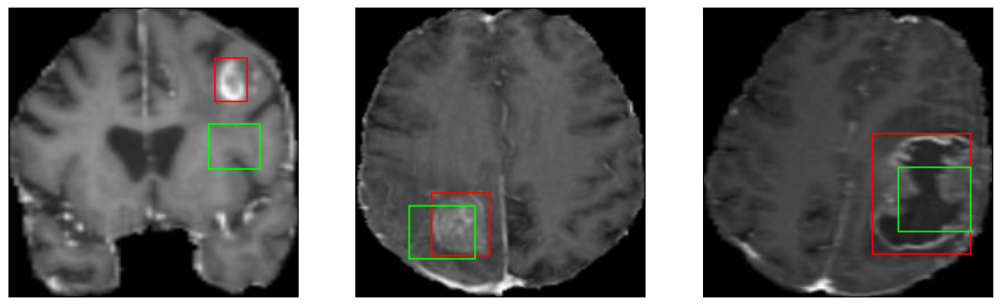

52/52 [==============================] - 10s 200ms/step - loss: 9.7660 - IoU: 0.3701 - val_loss: 10.1209 - val_IoU: 0.3973
Epoch 20/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


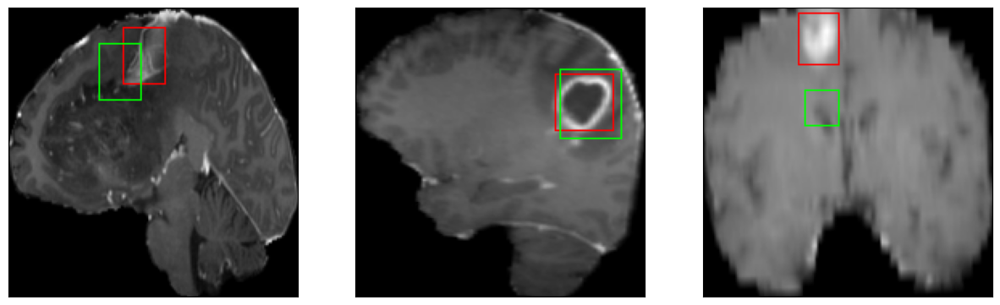

52/52 [==============================] - 10s 201ms/step - loss: 9.6654 - IoU: 0.3720 - val_loss: 11.0298 - val_IoU: 0.3425
Epoch 21/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 38ms/step
4


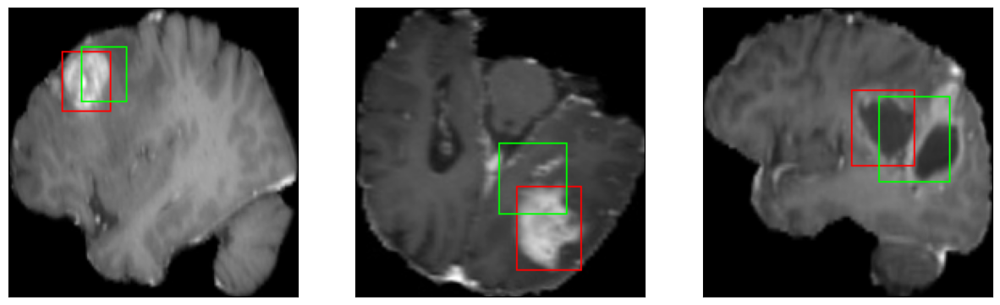

52/52 [==============================] - 11s 204ms/step - loss: 9.2054 - IoU: 0.3892 - val_loss: 10.5586 - val_IoU: 0.3682
Epoch 22/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


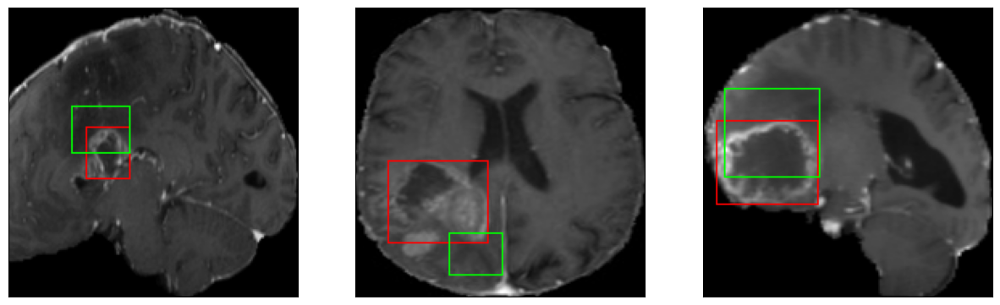

52/52 [==============================] - 10s 201ms/step - loss: 9.8137 - IoU: 0.3516 - val_loss: 10.2164 - val_IoU: 0.3925
Epoch 23/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


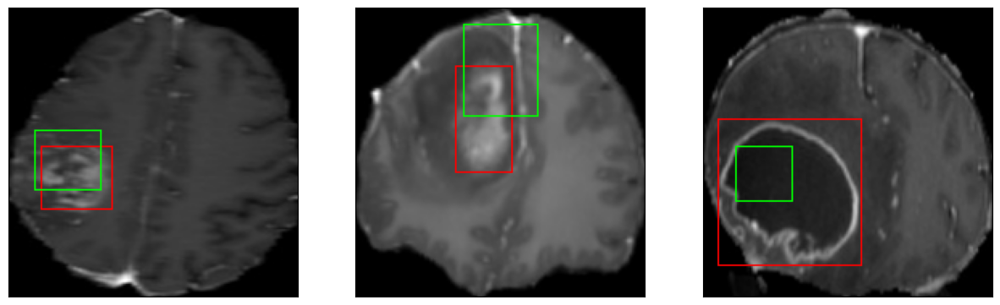

52/52 [==============================] - 11s 209ms/step - loss: 8.9314 - IoU: 0.3959 - val_loss: 11.7669 - val_IoU: 0.3273
Epoch 24/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


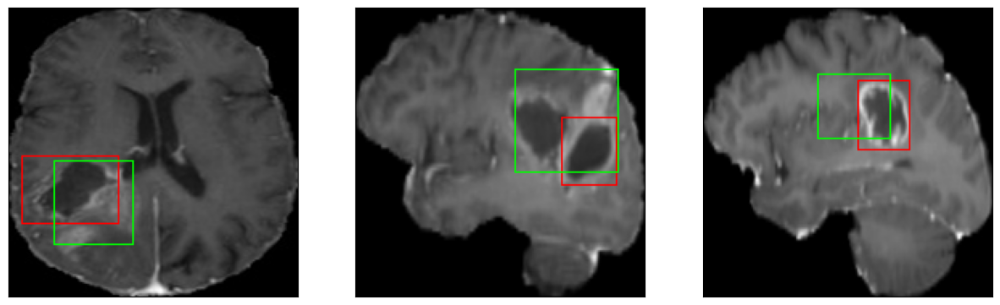

52/52 [==============================] - 11s 206ms/step - loss: 9.5720 - IoU: 0.3794 - val_loss: 10.9261 - val_IoU: 0.3748
Epoch 25/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


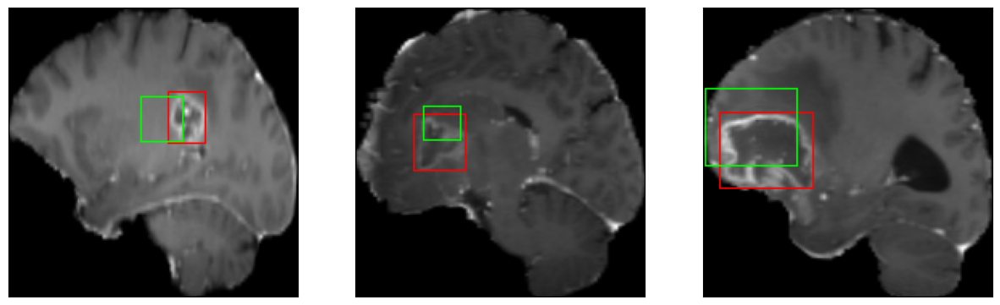

52/52 [==============================] - 10s 202ms/step - loss: 9.0643 - IoU: 0.3831 - val_loss: 10.8904 - val_IoU: 0.3406
Epoch 26/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


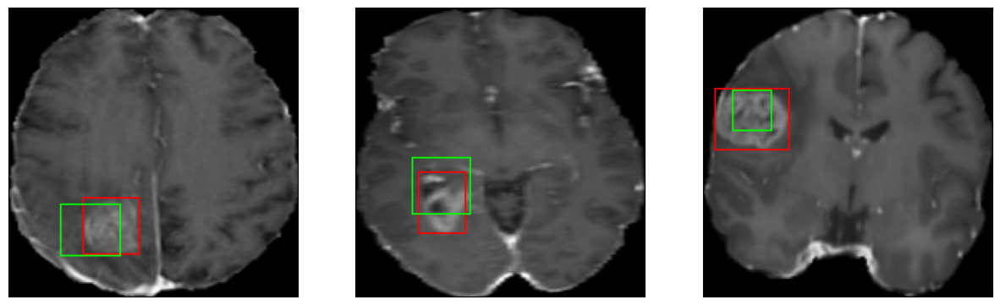

52/52 [==============================] - 11s 207ms/step - loss: 8.8165 - IoU: 0.3889 - val_loss: 9.3023 - val_IoU: 0.4457
Epoch 27/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


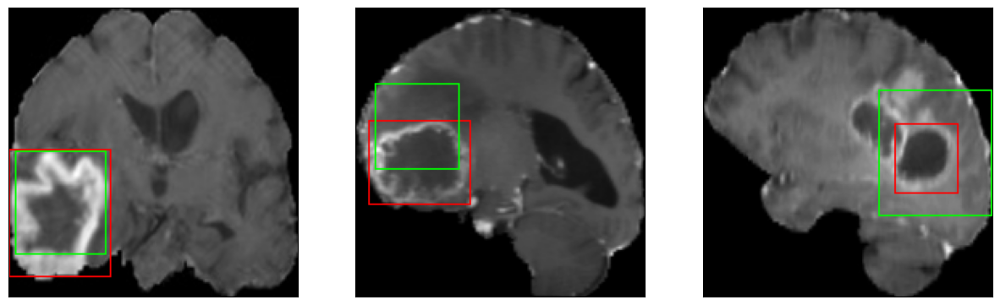

52/52 [==============================] - 10s 199ms/step - loss: 8.8546 - IoU: 0.3930 - val_loss: 10.2845 - val_IoU: 0.3872
Epoch 28/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


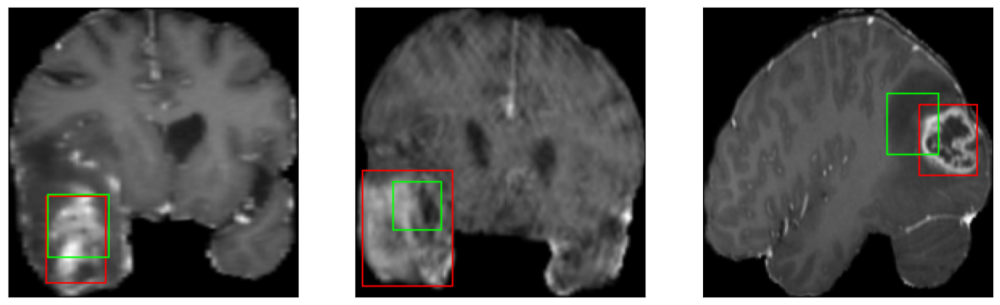

52/52 [==============================] - 10s 201ms/step - loss: 8.8050 - IoU: 0.4015 - val_loss: 10.8757 - val_IoU: 0.3659
Epoch 29/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


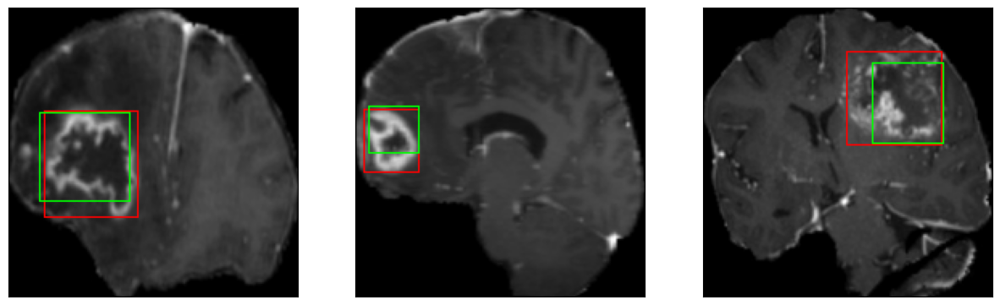

52/52 [==============================] - 11s 204ms/step - loss: 8.3723 - IoU: 0.4128 - val_loss: 8.9525 - val_IoU: 0.4280
Epoch 30/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


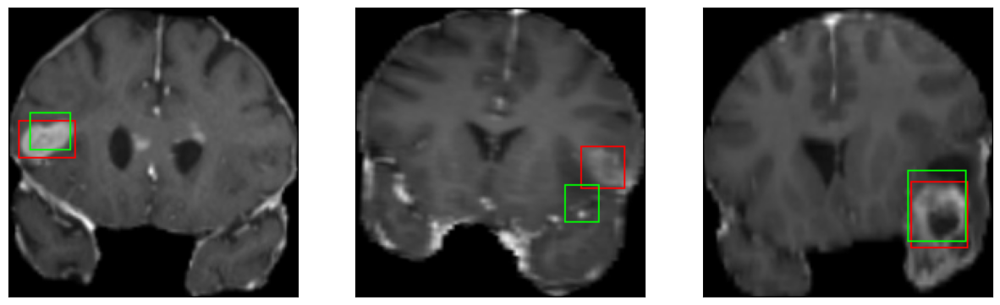

52/52 [==============================] - 10s 200ms/step - loss: 8.2248 - IoU: 0.4206 - val_loss: 10.1118 - val_IoU: 0.3499
Epoch 31/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


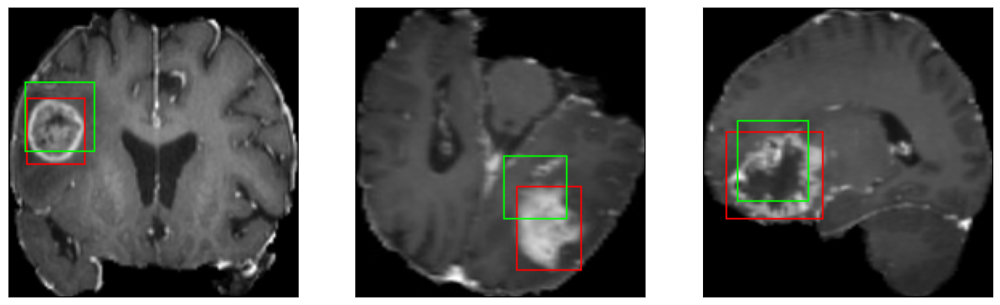

52/52 [==============================] - 11s 206ms/step - loss: 8.2724 - IoU: 0.4190 - val_loss: 9.4462 - val_IoU: 0.4013
Epoch 32/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


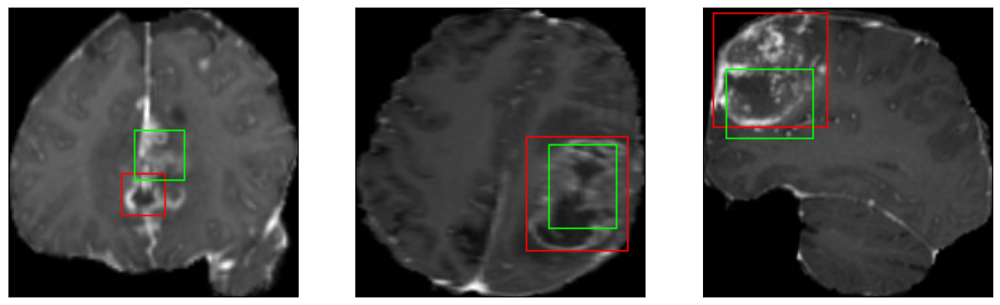

52/52 [==============================] - 11s 209ms/step - loss: 8.0654 - IoU: 0.4297 - val_loss: 8.7458 - val_IoU: 0.4482
Epoch 33/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


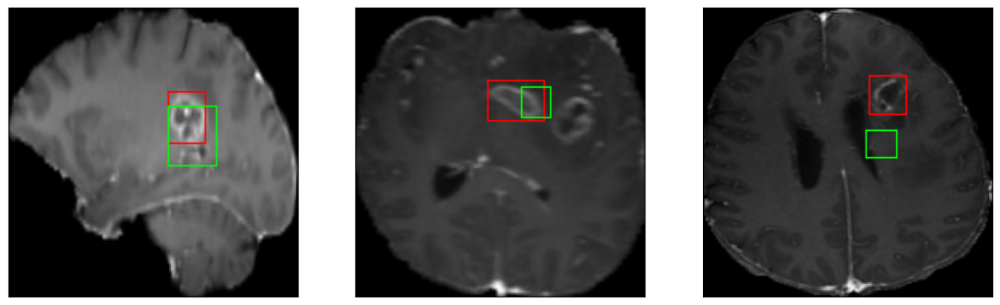

52/52 [==============================] - 11s 210ms/step - loss: 8.0809 - IoU: 0.4319 - val_loss: 9.8103 - val_IoU: 0.3833
Epoch 34/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


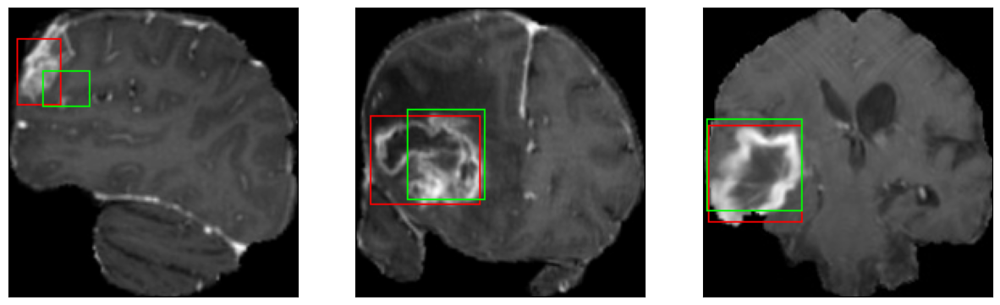

52/52 [==============================] - 11s 207ms/step - loss: 7.9691 - IoU: 0.4333 - val_loss: 9.6215 - val_IoU: 0.3764
Epoch 35/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


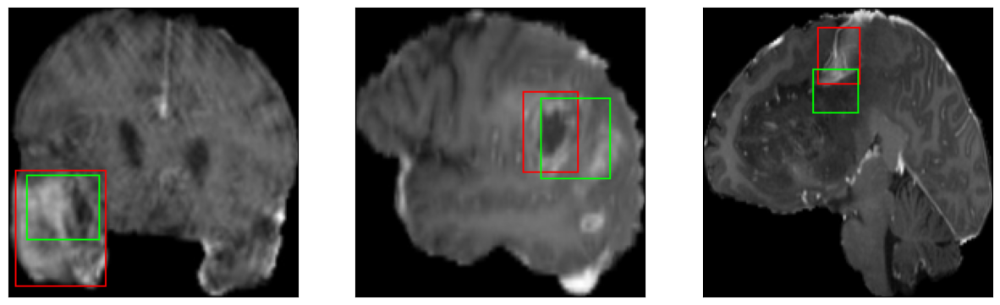

52/52 [==============================] - 11s 210ms/step - loss: 8.0006 - IoU: 0.4324 - val_loss: 9.6345 - val_IoU: 0.4421
Epoch 36/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


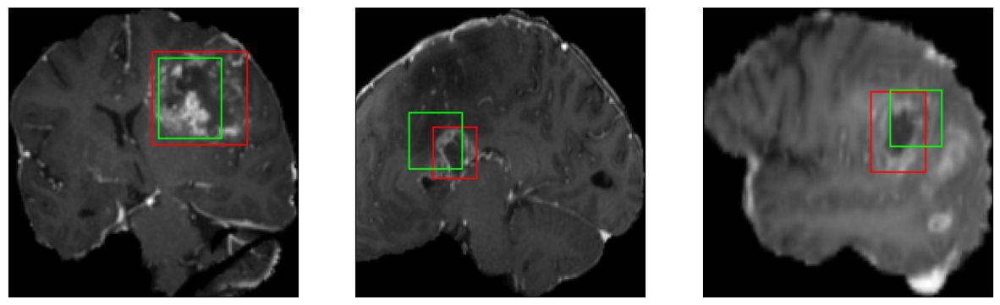

52/52 [==============================] - 10s 199ms/step - loss: 8.1454 - IoU: 0.4224 - val_loss: 11.2018 - val_IoU: 0.3266
Epoch 37/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


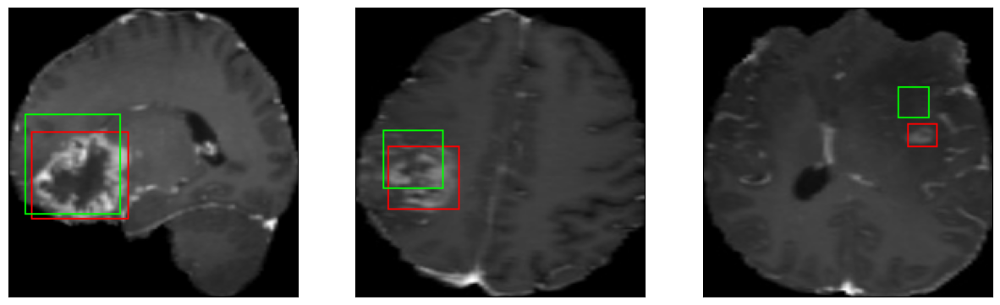

52/52 [==============================] - 11s 209ms/step - loss: 8.0167 - IoU: 0.4290 - val_loss: 11.1611 - val_IoU: 0.3055
Epoch 38/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 38ms/step
4


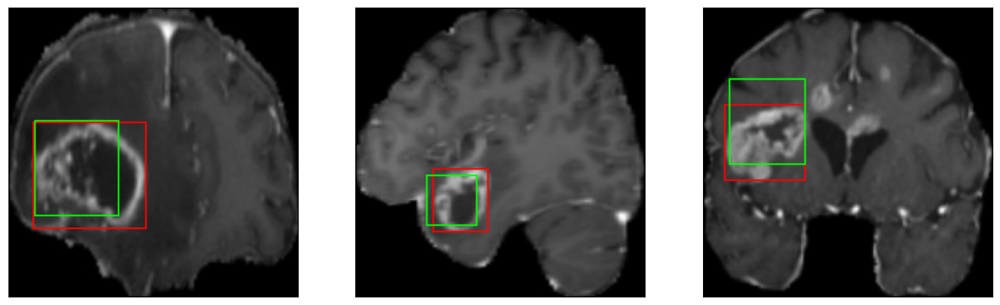

52/52 [==============================] - 10s 201ms/step - loss: 7.5934 - IoU: 0.4543 - val_loss: 9.7775 - val_IoU: 0.3852
Epoch 39/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


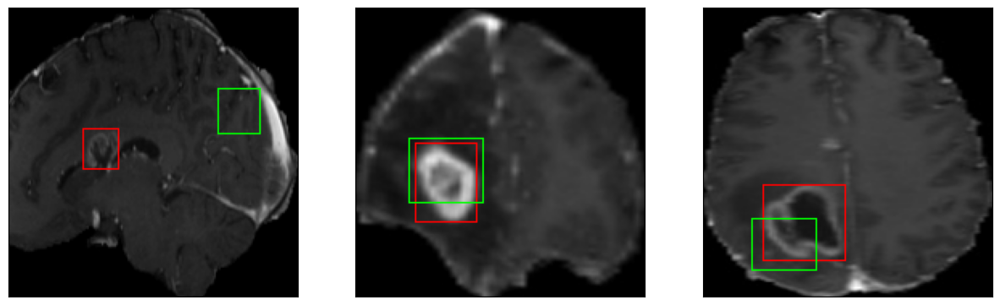

52/52 [==============================] - 11s 204ms/step - loss: 7.5539 - IoU: 0.4528 - val_loss: 8.7462 - val_IoU: 0.4420
Epoch 40/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


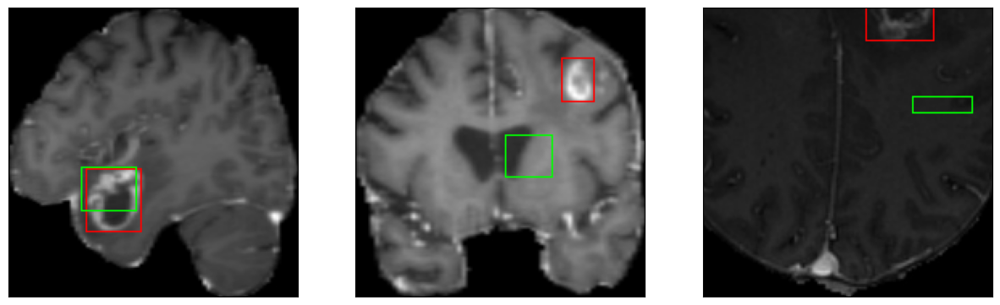

52/52 [==============================] - 11s 215ms/step - loss: 7.4621 - IoU: 0.4594 - val_loss: 10.1345 - val_IoU: 0.3872
Epoch 41/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4


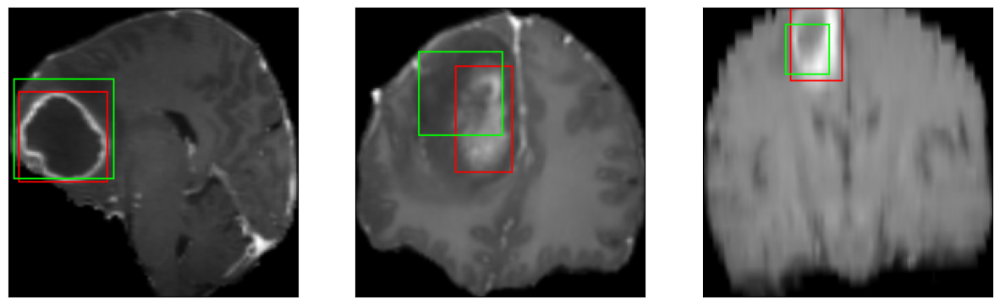

52/52 [==============================] - 11s 208ms/step - loss: 7.8572 - IoU: 0.4315 - val_loss: 8.7420 - val_IoU: 0.4539
Epoch 42/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


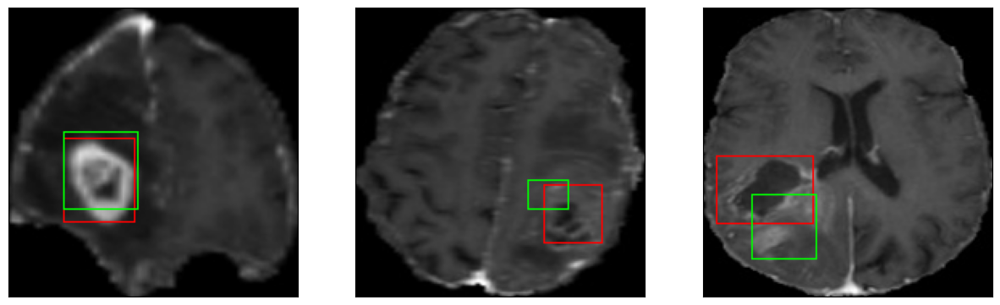

52/52 [==============================] - 10s 201ms/step - loss: 7.4310 - IoU: 0.4574 - val_loss: 9.5217 - val_IoU: 0.4006
Epoch 43/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


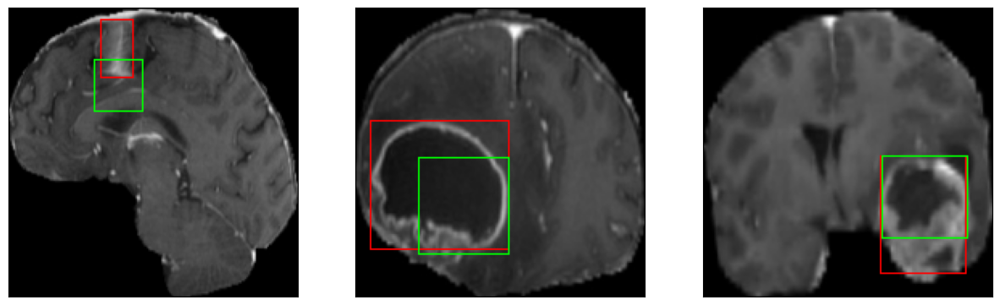

52/52 [==============================] - 11s 208ms/step - loss: 7.5805 - IoU: 0.4466 - val_loss: 8.4069 - val_IoU: 0.4715
Epoch 44/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 41ms/step
4


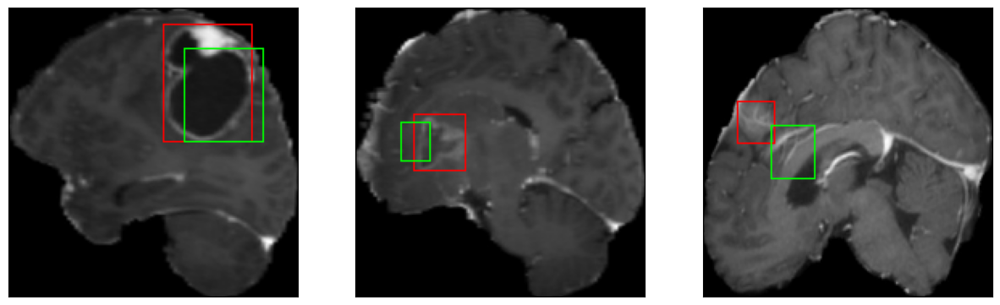

52/52 [==============================] - 11s 209ms/step - loss: 7.3805 - IoU: 0.4532 - val_loss: 9.4732 - val_IoU: 0.4219
Epoch 45/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


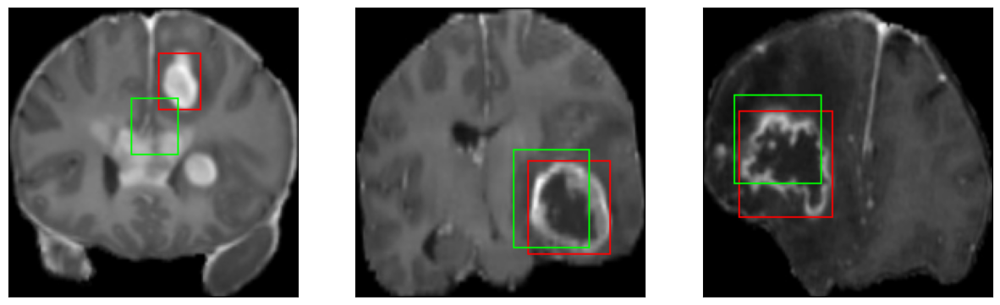

52/52 [==============================] - 11s 208ms/step - loss: 7.1124 - IoU: 0.4811 - val_loss: 9.3328 - val_IoU: 0.4153
Epoch 46/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


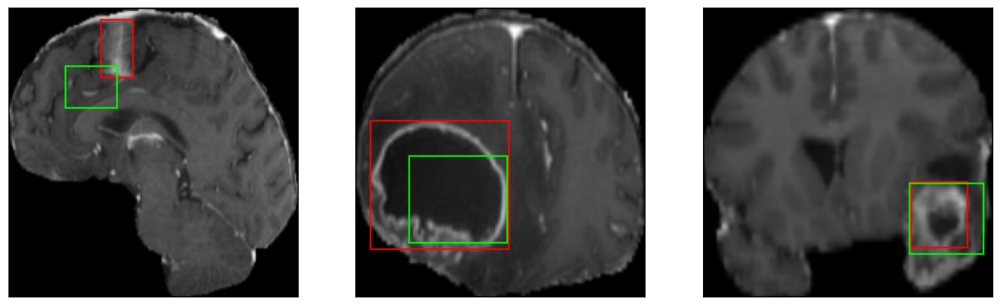

52/52 [==============================] - 11s 204ms/step - loss: 7.1642 - IoU: 0.4697 - val_loss: 8.8295 - val_IoU: 0.4918
Epoch 47/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 42ms/step
4


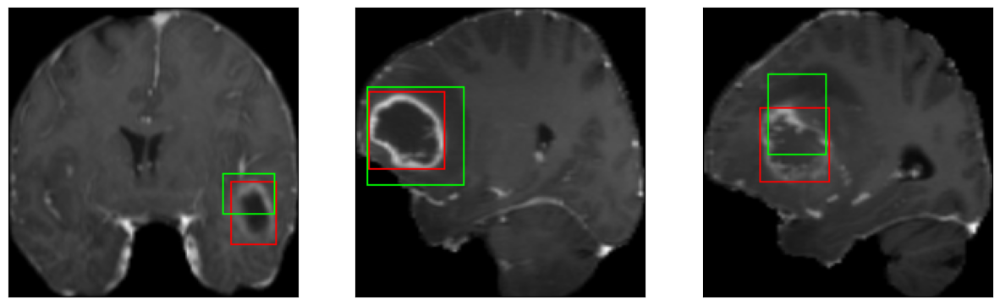

52/52 [==============================] - 11s 207ms/step - loss: 7.4213 - IoU: 0.4608 - val_loss: 8.9094 - val_IoU: 0.3990
Epoch 48/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


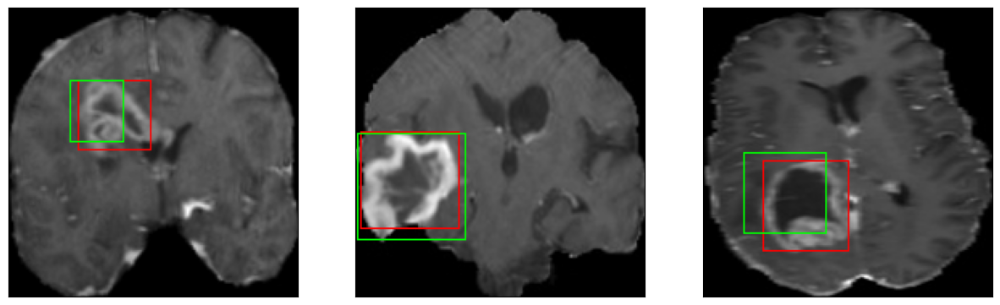

52/52 [==============================] - 11s 204ms/step - loss: 7.2713 - IoU: 0.4663 - val_loss: 8.2679 - val_IoU: 0.4486
Epoch 49/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


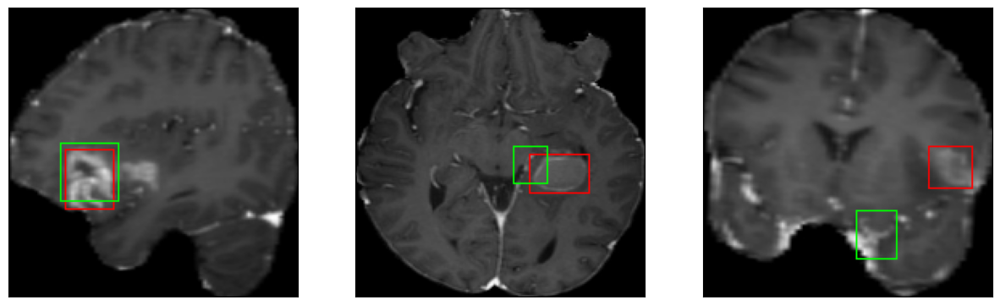

52/52 [==============================] - 10s 198ms/step - loss: 7.1394 - IoU: 0.4701 - val_loss: 8.7563 - val_IoU: 0.4431
Epoch 50/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


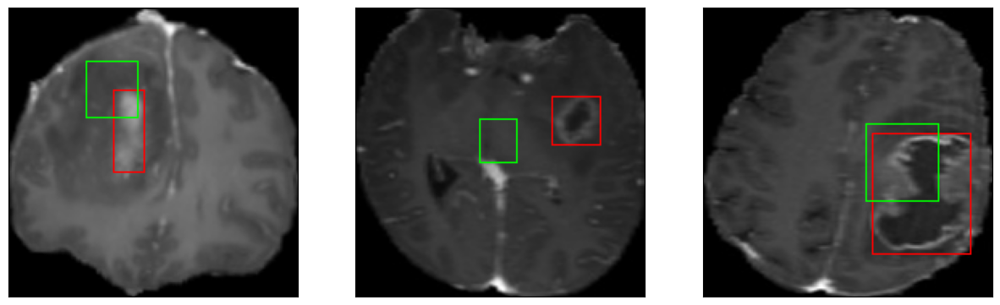

52/52 [==============================] - 10s 200ms/step - loss: 7.1773 - IoU: 0.4668 - val_loss: 9.1383 - val_IoU: 0.3905
Epoch 51/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


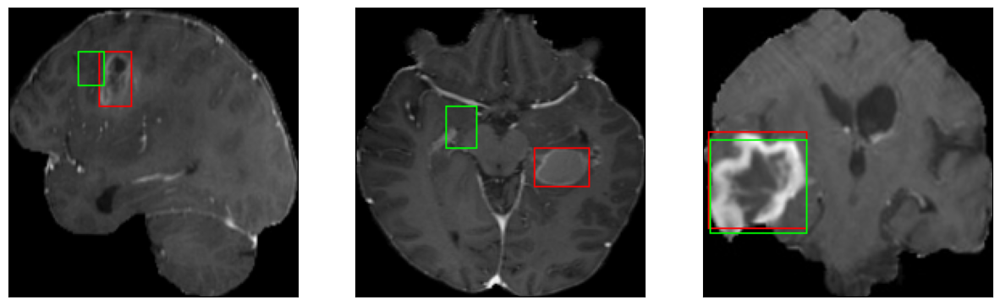

52/52 [==============================] - 11s 210ms/step - loss: 6.9530 - IoU: 0.4766 - val_loss: 8.2078 - val_IoU: 0.4594
Epoch 52/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


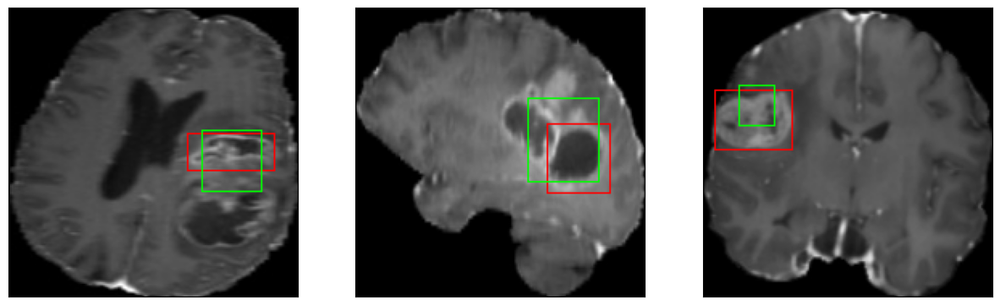

52/52 [==============================] - 11s 208ms/step - loss: 7.1980 - IoU: 0.4720 - val_loss: 9.6734 - val_IoU: 0.3826
Epoch 53/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


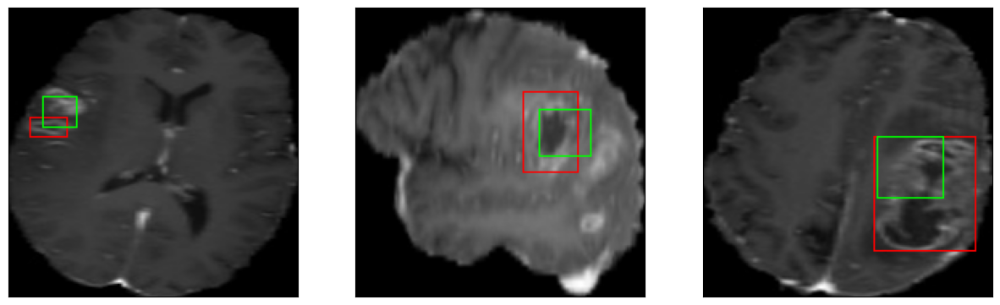

52/52 [==============================] - 11s 205ms/step - loss: 6.8854 - IoU: 0.4839 - val_loss: 10.4065 - val_IoU: 0.3479
Epoch 54/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


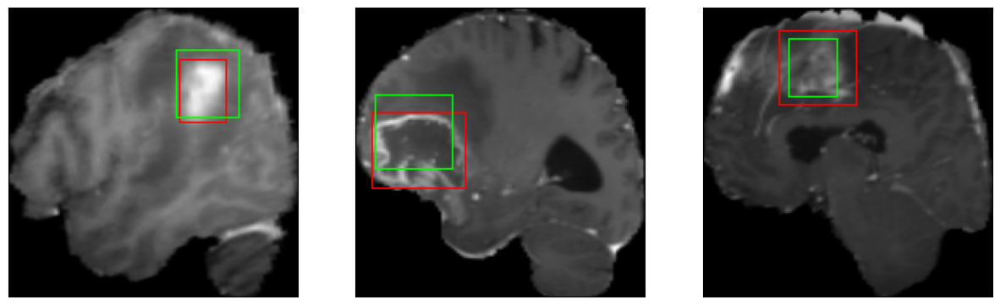

52/52 [==============================] - 11s 203ms/step - loss: 7.1200 - IoU: 0.4764 - val_loss: 8.3646 - val_IoU: 0.4685
Epoch 55/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


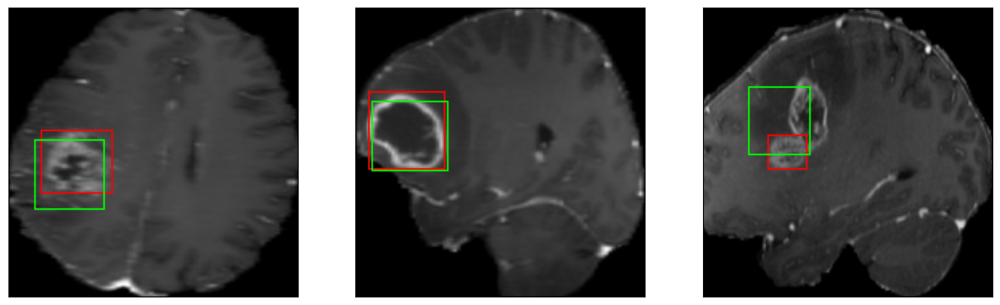

52/52 [==============================] - 11s 210ms/step - loss: 7.1263 - IoU: 0.4752 - val_loss: 9.4288 - val_IoU: 0.3971
Epoch 56/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


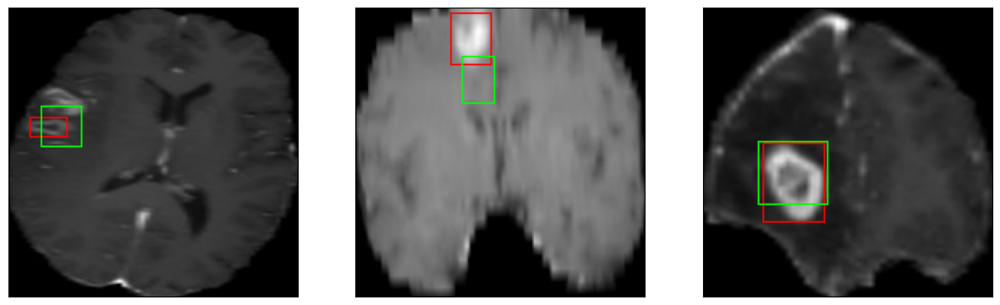

52/52 [==============================] - 10s 198ms/step - loss: 6.7426 - IoU: 0.4906 - val_loss: 9.3941 - val_IoU: 0.3894
Epoch 57/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


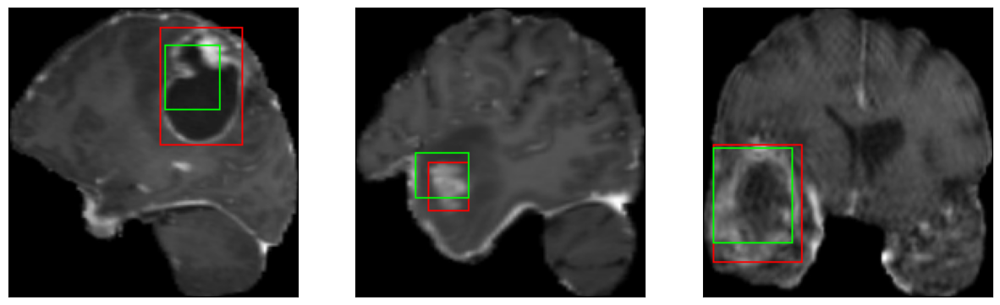

52/52 [==============================] - 10s 200ms/step - loss: 6.7327 - IoU: 0.4996 - val_loss: 8.4358 - val_IoU: 0.4512
Epoch 58/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


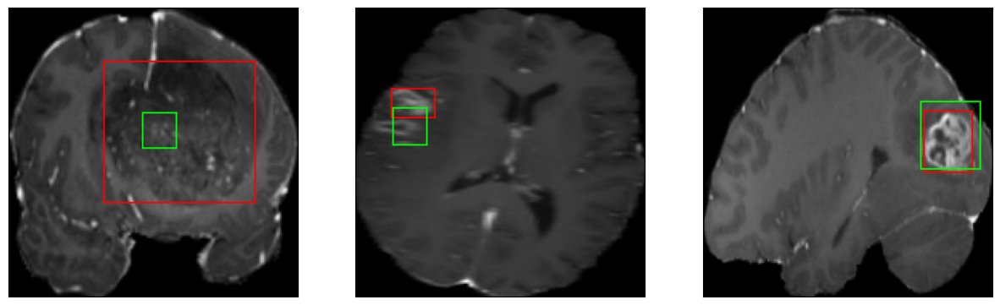

52/52 [==============================] - 11s 211ms/step - loss: 6.9174 - IoU: 0.4846 - val_loss: 8.8044 - val_IoU: 0.4178
Epoch 59/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


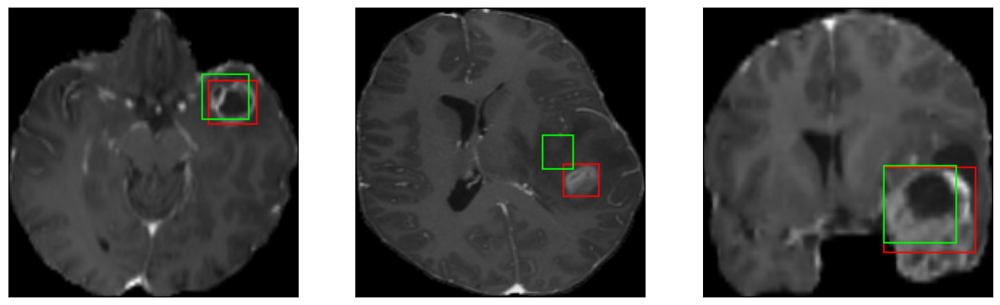

52/52 [==============================] - 10s 203ms/step - loss: 6.9138 - IoU: 0.4806 - val_loss: 8.9430 - val_IoU: 0.4284
Epoch 60/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


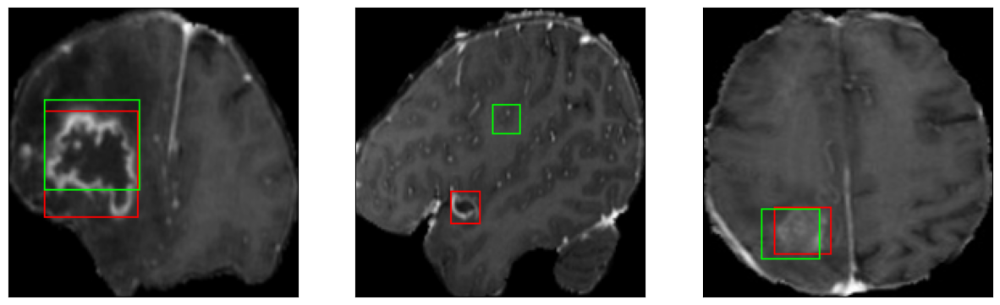

52/52 [==============================] - 11s 221ms/step - loss: 6.6988 - IoU: 0.4988 - val_loss: 8.7373 - val_IoU: 0.4507
Epoch 61/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 39ms/step
4


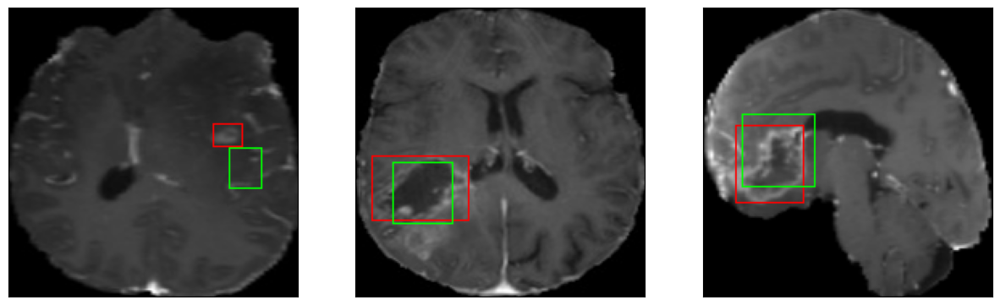

52/52 [==============================] - 11s 207ms/step - loss: 6.7239 - IoU: 0.4950 - val_loss: 8.4456 - val_IoU: 0.4677
Epoch 62/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4


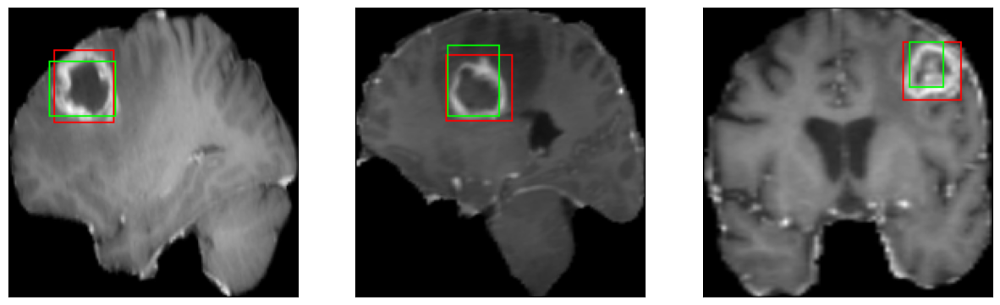

52/52 [==============================] - 10s 202ms/step - loss: 7.1079 - IoU: 0.4717 - val_loss: 9.6475 - val_IoU: 0.3911
Epoch 63/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


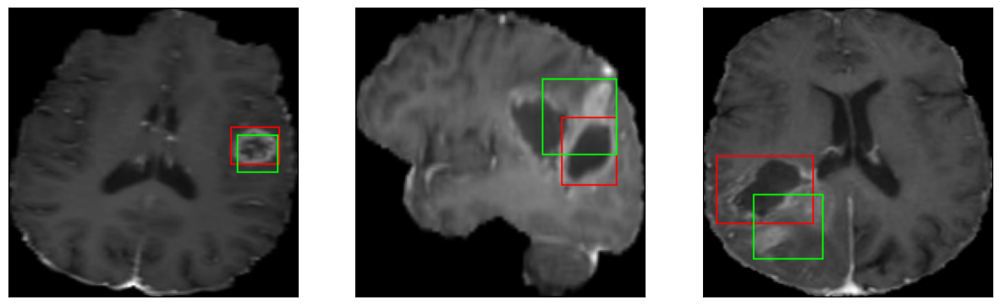

52/52 [==============================] - 10s 192ms/step - loss: 6.6502 - IoU: 0.4976 - val_loss: 9.6223 - val_IoU: 0.4071
Epoch 64/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


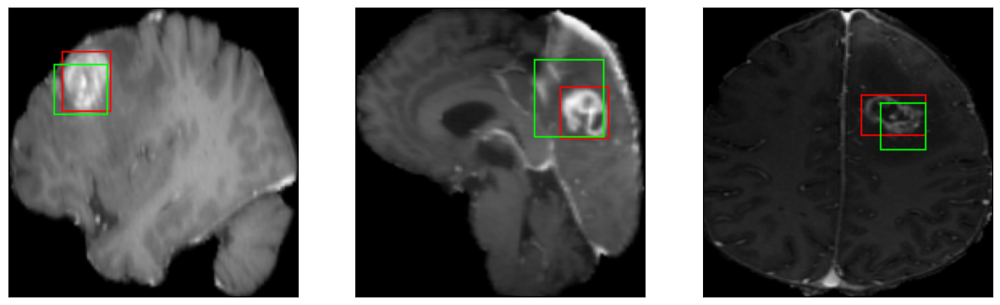

52/52 [==============================] - 11s 209ms/step - loss: 6.9158 - IoU: 0.4798 - val_loss: 8.4575 - val_IoU: 0.4514
Epoch 65/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


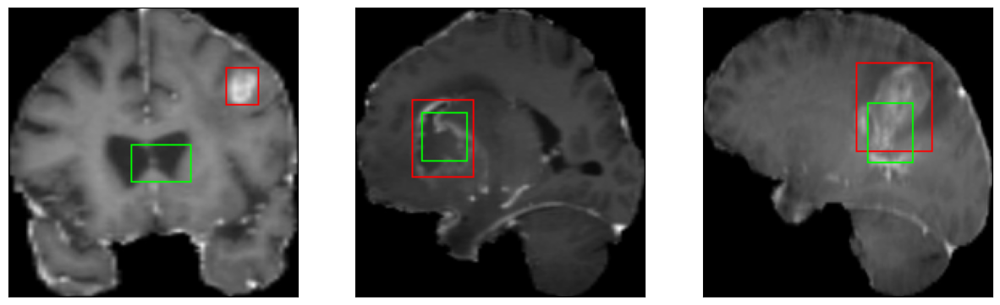

52/52 [==============================] - 11s 211ms/step - loss: 6.3267 - IoU: 0.5202 - val_loss: 9.2268 - val_IoU: 0.4328
Epoch 66/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


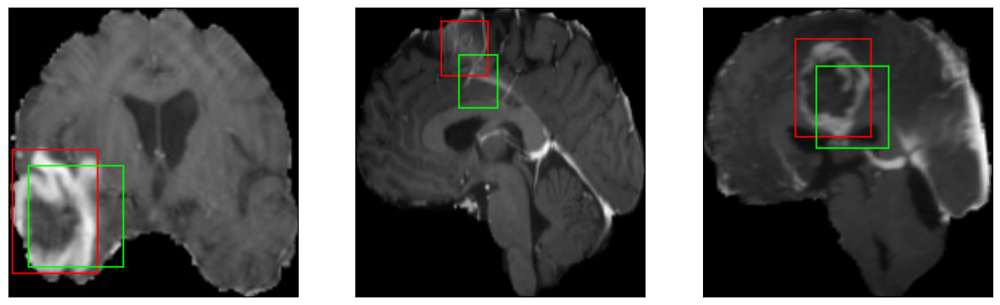

52/52 [==============================] - 11s 211ms/step - loss: 6.4814 - IoU: 0.5164 - val_loss: 7.8511 - val_IoU: 0.4889
Epoch 67/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


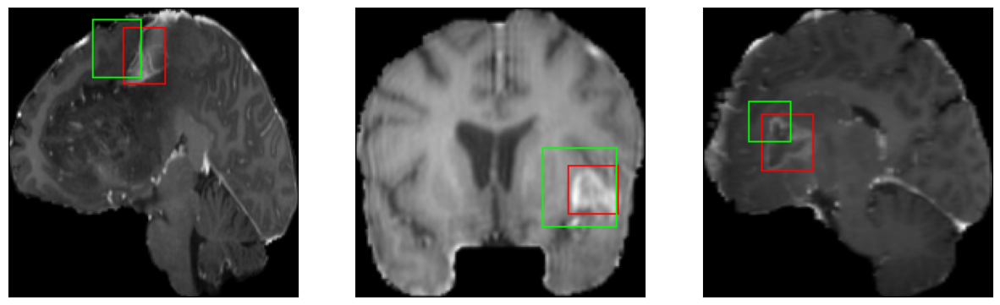

52/52 [==============================] - 11s 213ms/step - loss: 6.3655 - IoU: 0.5123 - val_loss: 9.0828 - val_IoU: 0.4796
Epoch 68/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


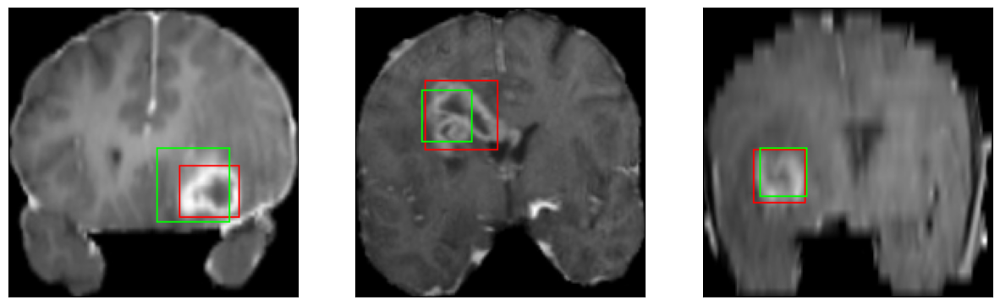

52/52 [==============================] - 11s 215ms/step - loss: 6.2347 - IoU: 0.5202 - val_loss: 9.1365 - val_IoU: 0.4316
Epoch 69/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


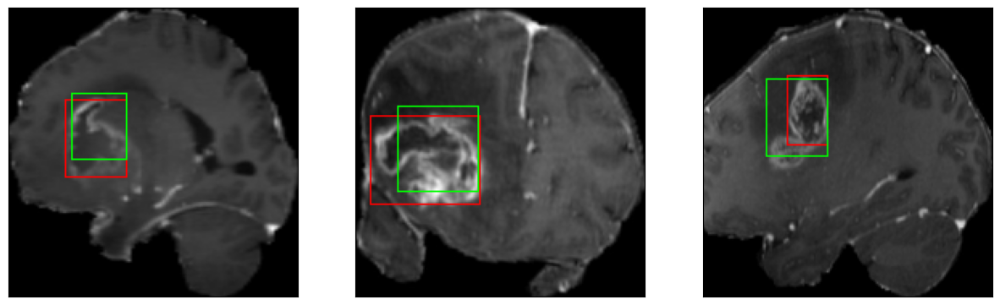

52/52 [==============================] - 10s 200ms/step - loss: 6.1672 - IoU: 0.5301 - val_loss: 9.0085 - val_IoU: 0.4178
Epoch 70/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


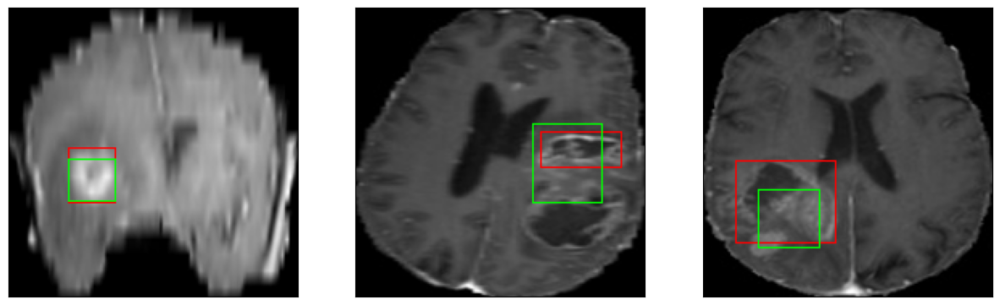

52/52 [==============================] - 11s 215ms/step - loss: 6.3419 - IoU: 0.5185 - val_loss: 9.1089 - val_IoU: 0.4129
Epoch 71/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


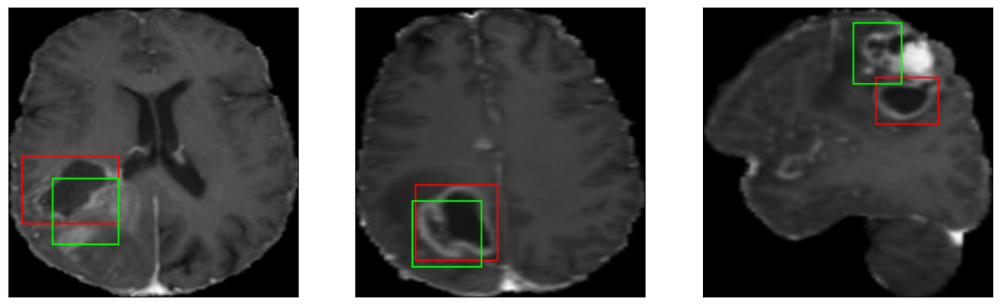

52/52 [==============================] - 11s 210ms/step - loss: 6.2586 - IoU: 0.5239 - val_loss: 8.6650 - val_IoU: 0.4502
Epoch 72/100
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 38ms/step
4


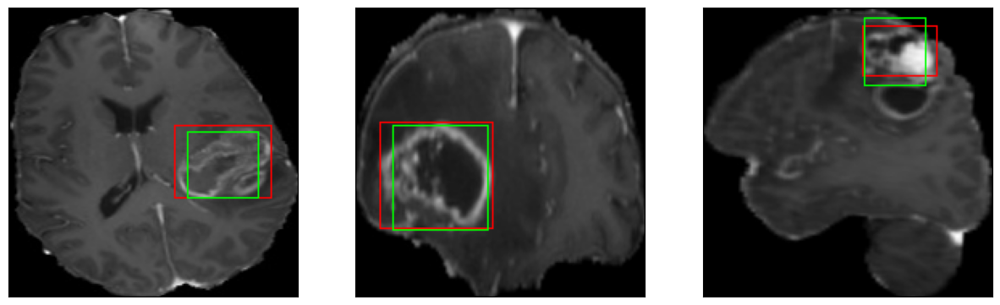

52/52 [==============================] - 10s 198ms/step - loss: 6.2281 - IoU: 0.5223 - val_loss: 7.7746 - val_IoU: 0.4977
Epoch 73/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


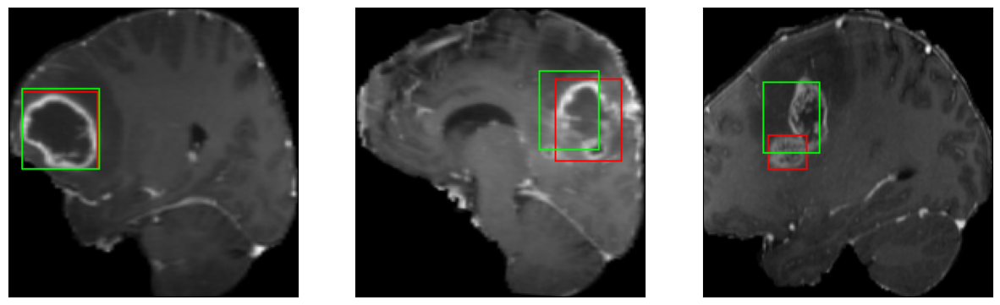

52/52 [==============================] - 11s 205ms/step - loss: 6.0523 - IoU: 0.5372 - val_loss: 8.6616 - val_IoU: 0.4560
Epoch 74/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


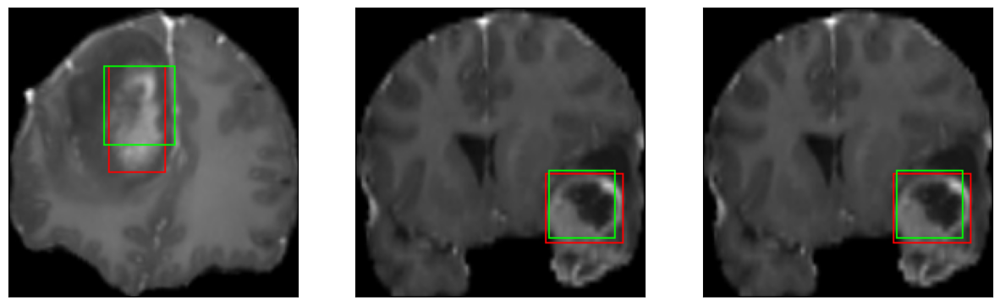

52/52 [==============================] - 11s 210ms/step - loss: 6.2645 - IoU: 0.5247 - val_loss: 8.2560 - val_IoU: 0.4996
Epoch 75/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


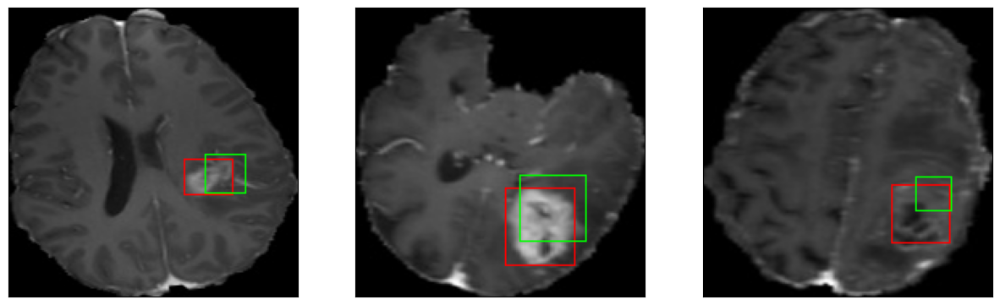

52/52 [==============================] - 11s 207ms/step - loss: 6.0527 - IoU: 0.5347 - val_loss: 7.8850 - val_IoU: 0.4910
Epoch 76/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


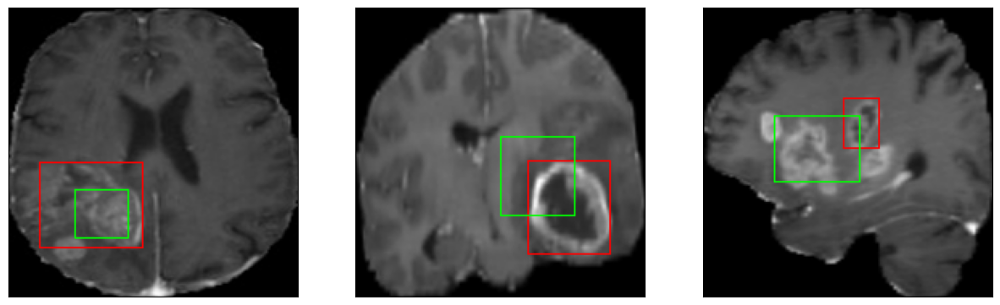

52/52 [==============================] - 11s 206ms/step - loss: 6.2852 - IoU: 0.5122 - val_loss: 9.6143 - val_IoU: 0.3827
Epoch 77/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


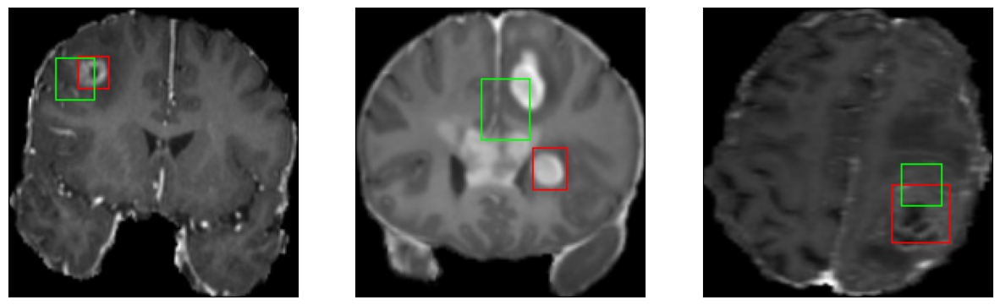

52/52 [==============================] - 11s 205ms/step - loss: 6.3467 - IoU: 0.5081 - val_loss: 9.5901 - val_IoU: 0.3904
Epoch 78/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


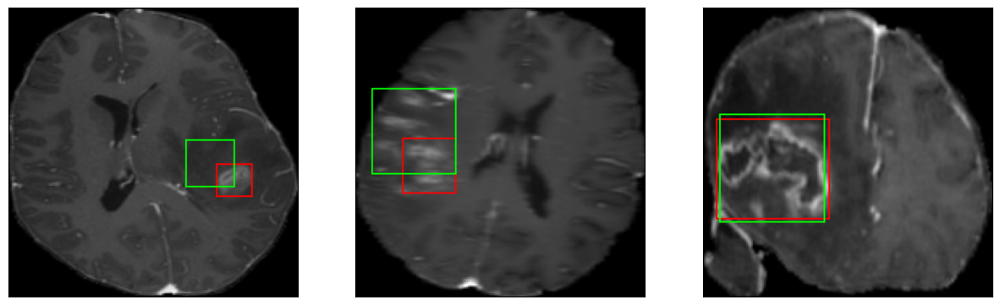

52/52 [==============================] - 11s 211ms/step - loss: 6.1158 - IoU: 0.5284 - val_loss: 8.6915 - val_IoU: 0.4456
Epoch 79/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


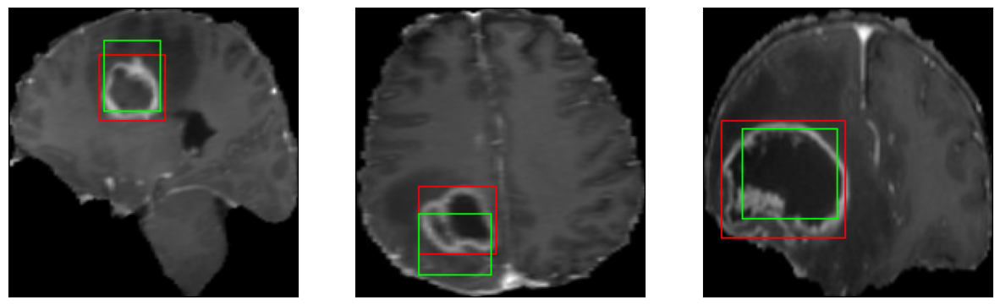

52/52 [==============================] - 10s 196ms/step - loss: 6.1299 - IoU: 0.5296 - val_loss: 8.5154 - val_IoU: 0.4461
Epoch 80/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 40ms/step
4


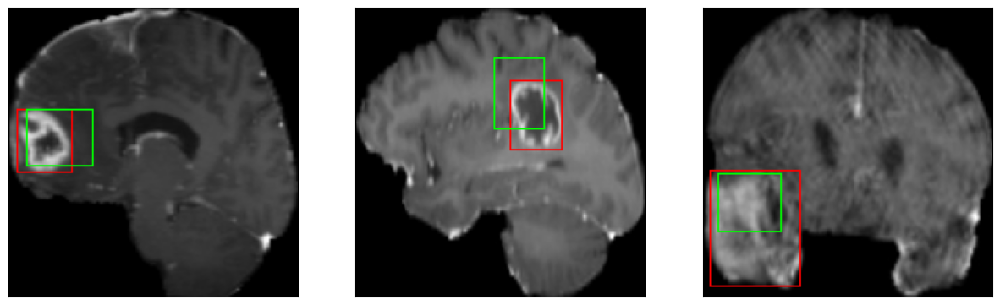

52/52 [==============================] - 11s 216ms/step - loss: 6.3063 - IoU: 0.5177 - val_loss: 8.5317 - val_IoU: 0.4436
Epoch 81/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


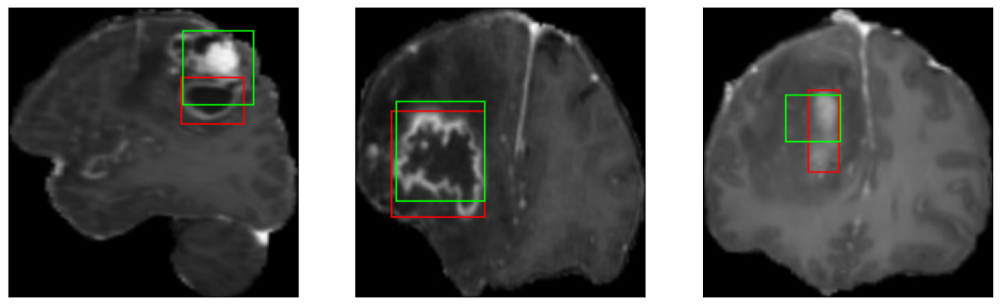

52/52 [==============================] - 11s 211ms/step - loss: 5.9457 - IoU: 0.5334 - val_loss: 7.9354 - val_IoU: 0.4947
Epoch 82/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


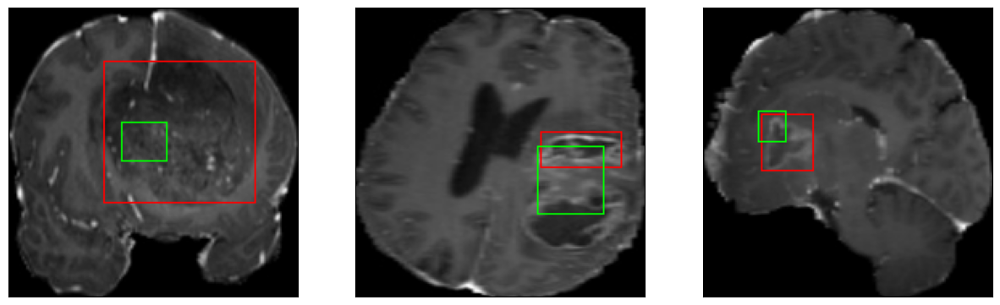

52/52 [==============================] - 11s 202ms/step - loss: 5.8949 - IoU: 0.5400 - val_loss: 8.3968 - val_IoU: 0.4499
Epoch 83/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4


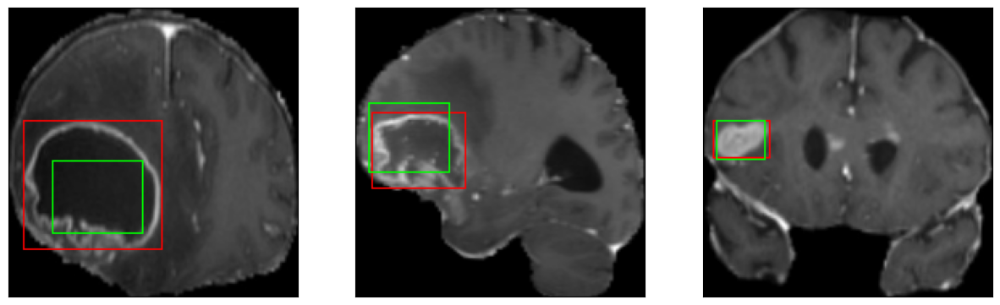

52/52 [==============================] - 11s 205ms/step - loss: 5.9618 - IoU: 0.5449 - val_loss: 8.4685 - val_IoU: 0.4400
Epoch 84/100
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 39ms/step
4


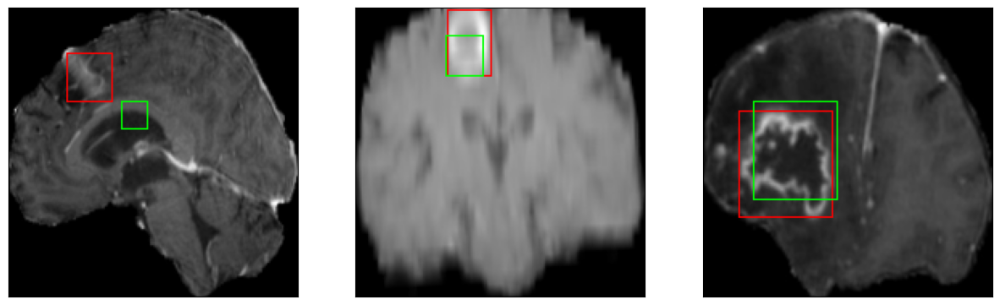

52/52 [==============================] - 11s 215ms/step - loss: 5.9006 - IoU: 0.5469 - val_loss: 8.3659 - val_IoU: 0.4527
Epoch 85/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


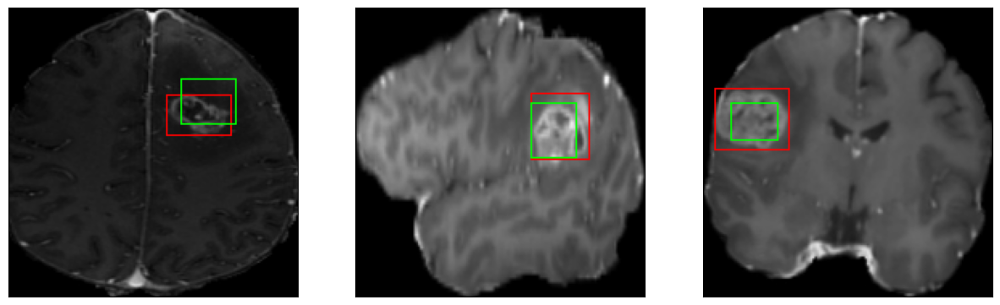

52/52 [==============================] - 11s 211ms/step - loss: 5.8644 - IoU: 0.5453 - val_loss: 8.3990 - val_IoU: 0.4635
Epoch 86/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


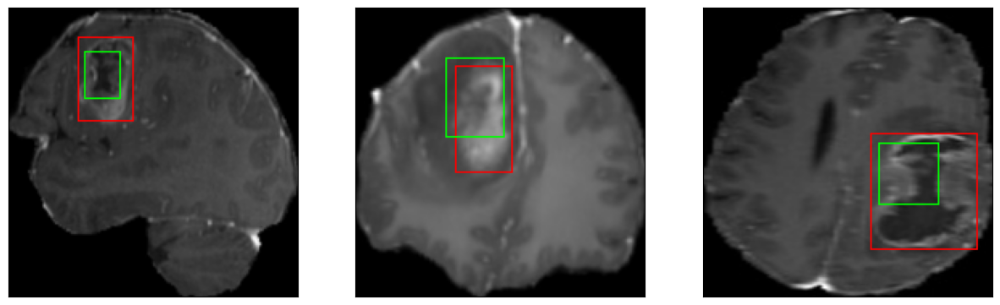

52/52 [==============================] - 11s 211ms/step - loss: 5.8557 - IoU: 0.5439 - val_loss: 10.0779 - val_IoU: 0.3746
Epoch 87/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


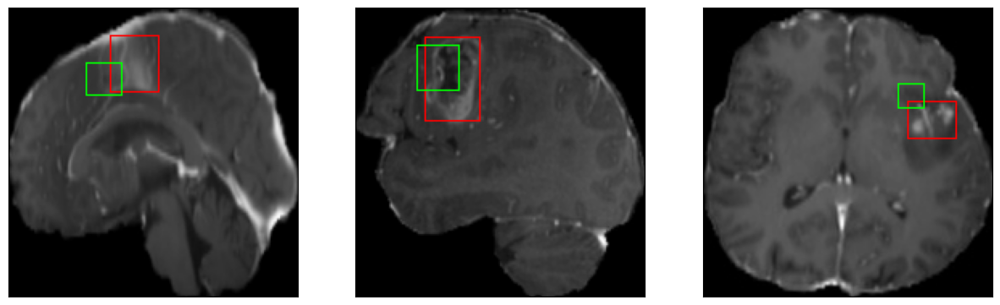

52/52 [==============================] - 11s 208ms/step - loss: 5.7397 - IoU: 0.5504 - val_loss: 10.5114 - val_IoU: 0.3337
Epoch 88/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


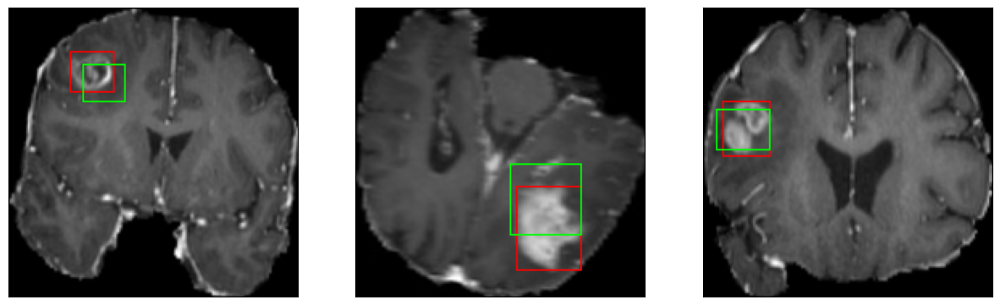

52/52 [==============================] - 10s 198ms/step - loss: 5.7712 - IoU: 0.5419 - val_loss: 8.2218 - val_IoU: 0.4531
Epoch 89/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


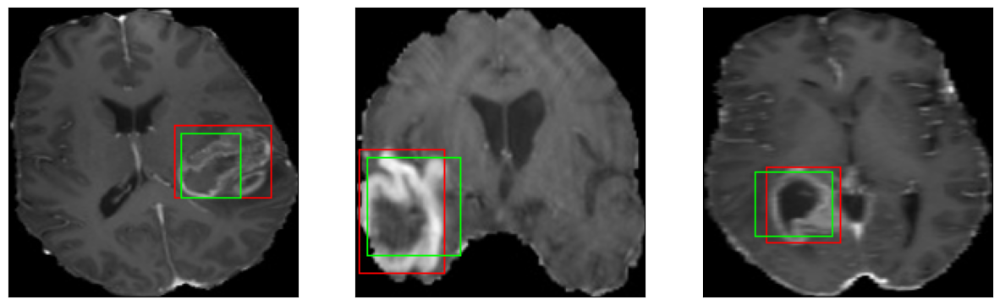

52/52 [==============================] - 10s 202ms/step - loss: 6.0706 - IoU: 0.5306 - val_loss: 8.2077 - val_IoU: 0.4790
Epoch 90/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


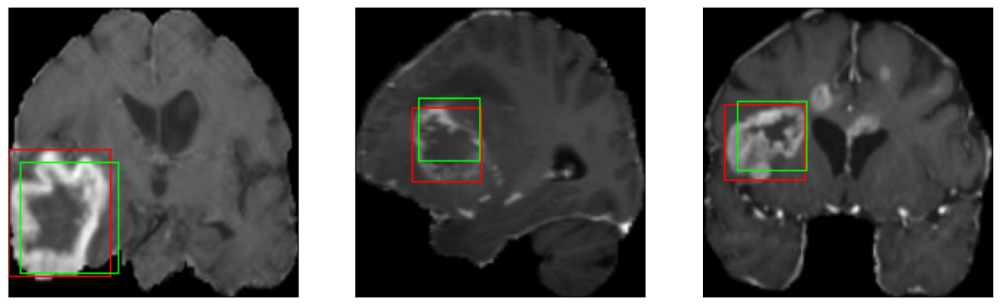

52/52 [==============================] - 11s 211ms/step - loss: 5.8185 - IoU: 0.5457 - val_loss: 8.6799 - val_IoU: 0.4413
Epoch 91/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


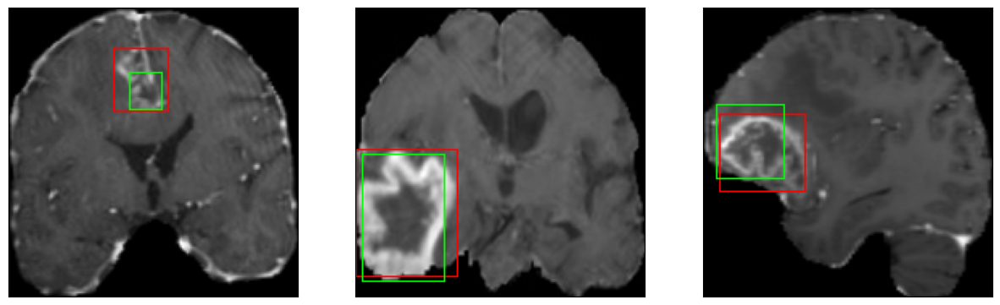

52/52 [==============================] - 11s 220ms/step - loss: 5.8104 - IoU: 0.5470 - val_loss: 8.2659 - val_IoU: 0.4700
Epoch 92/100
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


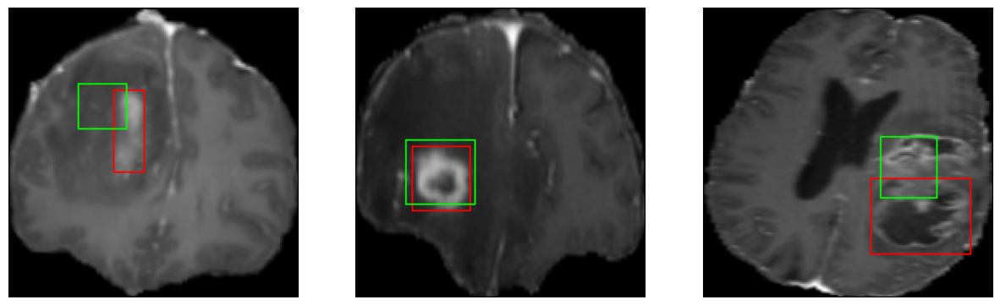

52/52 [==============================] - 11s 204ms/step - loss: 5.8448 - IoU: 0.5449 - val_loss: 8.1729 - val_IoU: 0.4586
Epoch 93/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


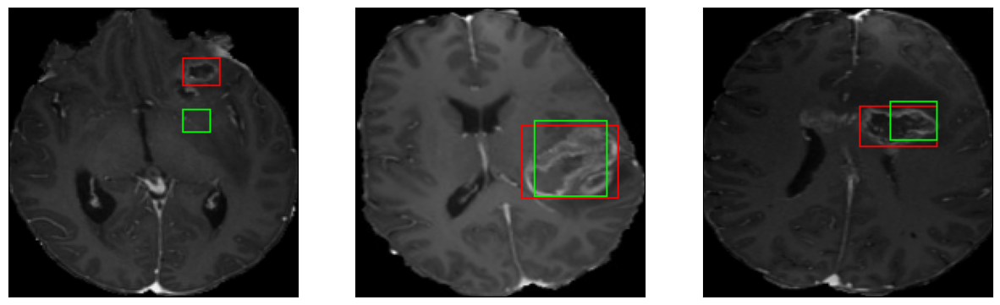

52/52 [==============================] - 11s 210ms/step - loss: 5.6720 - IoU: 0.5579 - val_loss: 8.0328 - val_IoU: 0.5025
Epoch 94/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


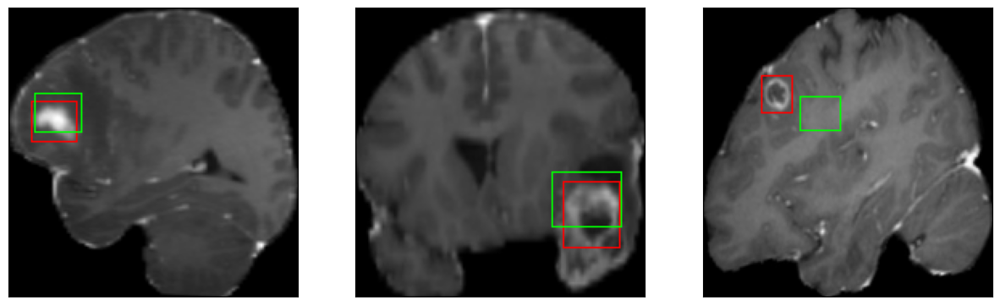

52/52 [==============================] - 11s 214ms/step - loss: 5.7810 - IoU: 0.5445 - val_loss: 8.3128 - val_IoU: 0.4550
Epoch 95/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


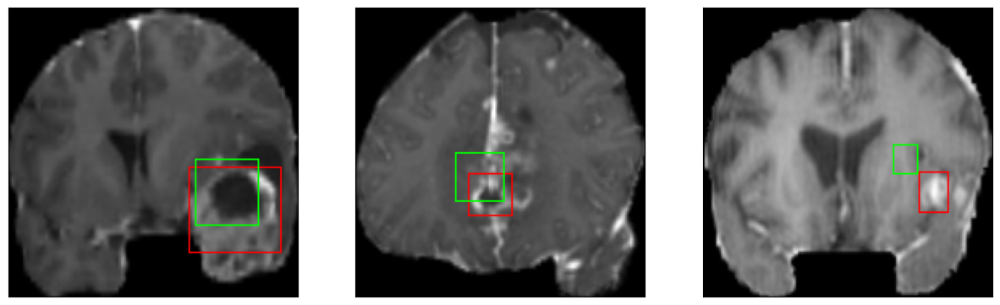

52/52 [==============================] - 11s 205ms/step - loss: 5.7353 - IoU: 0.5460 - val_loss: 8.8377 - val_IoU: 0.4374
Epoch 96/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


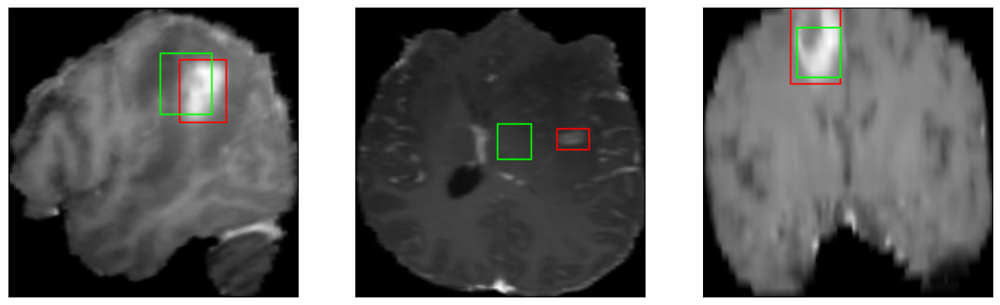

52/52 [==============================] - 10s 200ms/step - loss: 5.8115 - IoU: 0.5404 - val_loss: 7.6561 - val_IoU: 0.4885
Epoch 97/100
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 38ms/step
4


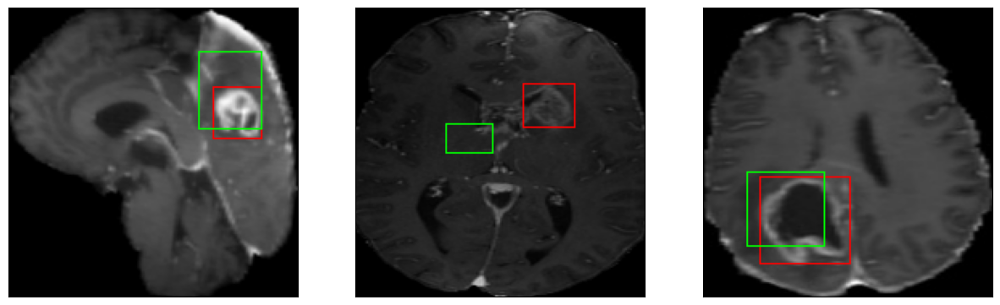

52/52 [==============================] - 11s 205ms/step - loss: 5.5277 - IoU: 0.5628 - val_loss: 8.1446 - val_IoU: 0.4682
Epoch 98/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 38ms/step
4
8/8 [==============================] - 0s 37ms/step
4


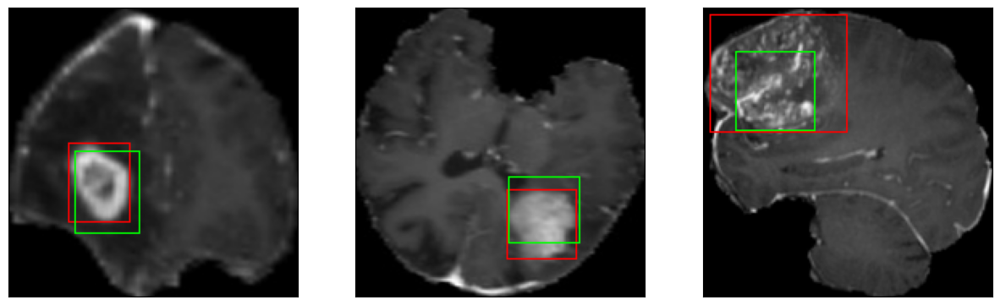

52/52 [==============================] - 11s 209ms/step - loss: 5.7937 - IoU: 0.5464 - val_loss: 7.7209 - val_IoU: 0.5170
Epoch 99/100
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 37ms/step
4
8/8 [==============================] - 0s 38ms/step
4


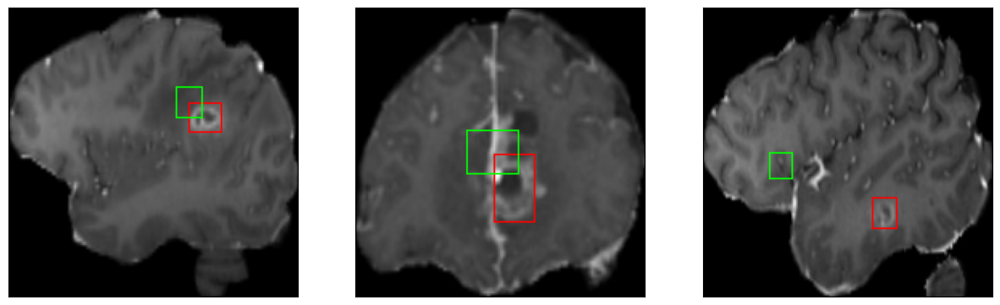

52/52 [==============================] - 11s 205ms/step - loss: 5.7183 - IoU: 0.5529 - val_loss: 8.1454 - val_IoU: 0.4635
Epoch 100/100
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 37ms/step
4


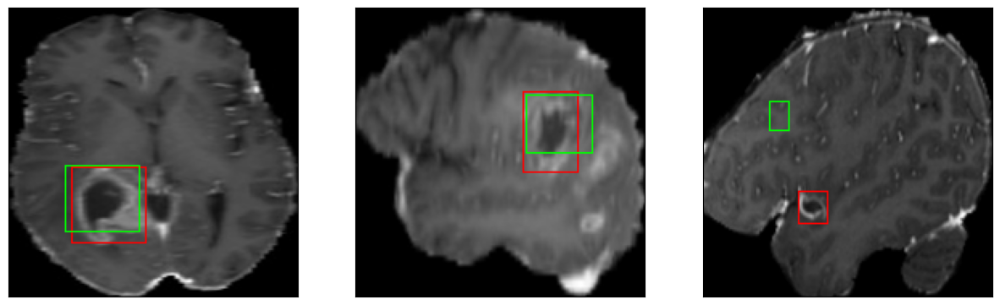

52/52 [==============================] - 11s 215ms/step - loss: 5.6038 - IoU: 0.5564 - val_loss: 9.2063 - val_IoU: 0.4165


In [23]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

<Axes: >

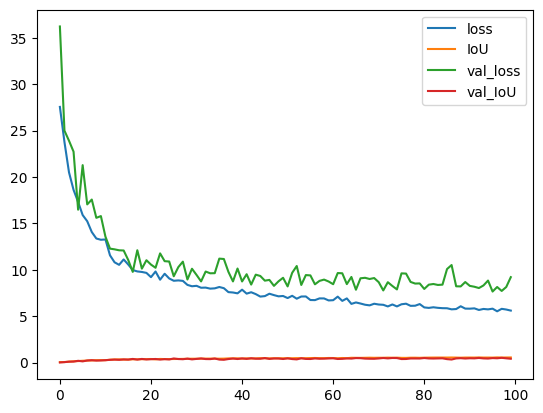

In [24]:
pd.DataFrame(model.history.history).plot()

In [27]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 55ms/step - loss: 10.4603 - IoU: 0.3481


[10.460254669189453, 0.3481470048427582]